<a href="https://colab.research.google.com/github/alirezabayatmk/BotDetection/blob/master/Twitter_User_Segmentation_and_Bot_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Description**

**Introduction**

The rise of web services and popularity of online social networks (OSN) like Facebook, Twitter, LinkedIn etc. have led to the rise of social bots as automated social actors. 

Followings are the Goals of these Bots:
1. Infiltrating Human Conversations
2. Scamming
3. Impersonation & identity fraud : promoting ideologies / scam / mislead
4. Misinformation / Disinformation Dissemination
5. Stock Market Manipulation
6. Astroturfing
7. Content Pollution

Types of their activity:
1. Generating Pseudo-posts
2. Reposting
3. Adding Comments or Likes
4. Building Conncetions

---


**Methods and Approaches**

1. **Topological (structure-based)**
> * Random Walk
> * Markov Random Field & Loopy Belief Propagation

2. **Crowdsourcing**

3. **Feature-based Machine Learning**
> * Network-centric Features
> * User Profile Metadata
> * Friends & Followings Metadata
> * Temporal Metadata
> * Content
> * Sentiment


---


**Purpose of This Project**

Farsi Being a low-resource language in comparison to English, lacks sophisticated methods and high quality datasets specially for Social Media Analysis. The purpose of this project is to detect persian twitter bots using handcrafted features and minimal data with an acceptable accuracy.

# **Mounting Google Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **Importing Libraries**

**fuzzywuzzy**: It uses Levenshtein Distance to calculate the differences between sequences in a simple-to-use package.

**fastText**: is a library for efficient learning of word representations and sentence classification.

**shutil**: helps you automate copying files and directories.

**ast**: helps Python applications to process trees of the Python abstract syntax grammar.



In [ ]:
pip install emojis fuzzywuzzy urlextract fasttext bioinfokit category_encoders botometer

In [ ]:
# Data
import glob
import pandas as pd
import numpy as np
import shutil

# Preprocessing
import re
import ast
import emojis
from urlextract import URLExtract
from sklearn import preprocessing 
from datetime import datetime
import fasttext

# Distances
from fuzzywuzzy import fuzz
from fuzzywuzzy import process

# Encoding
import category_encoders as ce
from sklearn.preprocessing import LabelBinarizer
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_extraction.text import CountVectorizer

# Visualization
from bioinfokit.visuz import cluster
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Machine Learning
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.manifold import TSNE
from sklearn.cluster import SpectralClustering
from sklearn.decomposition import PCA

# Twitter
import botometer
import tweepy

# Time
import time

/usr/local/lib/python3.6/dist-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')
/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# **Unification** (if mini csv files changed) => refined_users.csv


**merging all crawled csv files into a single file**

In [ ]:
path = '/content/drive/My Drive/twitter_users_metadata(covid)'
all_files = glob.glob(path + "/*.csv")

li = []

for filename in all_files:
    df = pd.read_csv(filename, index_col=None, header=0)
    li.append(df)

frame = pd.concat(li, axis=0, ignore_index=True)
frame.to_csv('all_users.csv')
# shutil.copy("{}".format(esm), "/content/drive/My Drive/twitter users metadata(covid)")

**Loading newly created file**

In [ ]:
path = '/content/all_users.csv'
data = pd.read_csv(path)
data = data.drop(columns=['Unnamed: 0'])
data

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (0,1,2,3,4,5,6,7,8,9,10,11,13,14,15) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,user_id,username,user_screenname,location,description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,default_profile,default_profile_image
0,1232250616988262400,محد جواد رسولی,RasooliMj,NaN,تیم اجرایی تلویزیون اینترنتی شرجی https://t.co...,56,111,38,45,False,False,0.0,2020-02-25 10:27:04,True,False
1,872464367698272256,🇮🇷 Engineer,MjMj656565,Islamic Republic of Iran,‏‏‏‏کارشناس ارشد مکانیک ساخت و تولید.\nارزشی ا...,243,292,10955,17948,False,False,1.0,2017-06-07 14:44:49,True,False
2,1143848825553117184,Tinix,Taningh1,NaN,𓃠,214,179,400,4202,False,False,0.0,2019-06-26 11:49:46,True,False
3,989452221761904641,mehrdad🏳,refighe_bad,depression,"Not much better than me,but no one like me ...",3337,3317,38915,66501,False,False,2.0,2018-04-26 10:32:47,True,False
4,2578250978,Seied Pourmousavi,sapourmousavi,NaN,NaN,5,127,72,100,False,False,0.0,2014-06-20 07:42:27,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
269346,1.14477e+18,Nariman Masoudi,2xSp0cT9EYHH2uq,ایرانشهر,‏‏‏‏‏‏‏‏‏نریمان,227,507,12625,18561,False,False,0.0,2019-06-29 00:59:20,True,False
269347,1.21642e+18,Saturn,saturn_2281,Shiraz,make a wish to have sth better than what u lost,317,247,7696,9870,False,False,0.0,2020-01-12 17:54:05,True,False
269348,1.22894e+18,Khatun,roghayehkhatun,NaN,NaN,23,47,40,132,False,False,0.0,2020-02-16 07:26:50,True,False
269349,1.22184e+18,AmmareAli,ali_ammare,NaN,NaN,18,0,210,952,False,False,0.0,2020-01-27 17:13:06,True,False


**checking data types**

In [ ]:
print(data.columns.values)
print(data.dtypes)

['user_id' 'username' 'user_screenname' 'location' 'description'
 'followers_count' 'friends_count' 'statuses_count' 'favourites_count'
 'verified' 'protected' 'listed_count' 'created_at' 'default_profile'
 'default_profile_image']
user_id                   object
username                  object
user_screenname           object
location                  object
description               object
followers_count           object
friends_count             object
statuses_count            object
favourites_count          object
verified                  object
protected                 object
listed_count             float64
created_at                object
default_profile           object
default_profile_image     object
dtype: object


**removing mixed data type rows**

In [ ]:
pb = data[~data['default_profile_image'].apply(lambda x: isinstance(x, bool))]
pb = pb.reset_index(drop=True)
pb.to_csv('problematic_metas.csv')
# shutil.copy("{}".format(esm), "/content/drive/My Drive/twitter users metadata(covid)")

**keeping only the correct form of data**

In [ ]:
data = data[data['default_profile_image'].apply(lambda x: isinstance(x, bool))]
data = data.reset_index(drop=True)
data

,user_id,username,user_screenname,location,description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,default_profile,default_profile_image
0,1232250616988262400,محد جواد رسولی,RasooliMj,NaN,تیم اجرایی تلویزیون اینترنتی شرجی https://t.co...,56,111,38,45,False,False,0.0,2020-02-25 10:27:04,True,False
1,872464367698272256,🇮🇷 Engineer,MjMj656565,Islamic Republic of Iran,‏‏‏‏کارشناس ارشد مکانیک ساخت و تولید.\nارزشی ا...,243,292,10955,17948,False,False,1.0,2017-06-07 14:44:49,True,False
2,1143848825553117184,Tinix,Taningh1,NaN,𓃠,214,179,400,4202,False,False,0.0,2019-06-26 11:49:46,True,False
3,989452221761904641,mehrdad🏳,refighe_bad,depression,"Not much better than me,but no one like me ...",3337,3317,38915,66501,False,False,2.0,2018-04-26 10:32:47,True,False
4,2578250978,Seied Pourmousavi,sapourmousavi,NaN,NaN,5,127,72,100,False,False,0.0,2014-06-20 07:42:27,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
229564,1.14477e+18,Nariman Masoudi,2xSp0cT9EYHH2uq,ایرانشهر,‏‏‏‏‏‏‏‏‏نریمان,227,507,12625,18561,False,False,0.0,2019-06-29 00:59:20,True,False
229565,1.21642e+18,Saturn,saturn_2281,Shiraz,make a wish to have sth better than what u lost,317,247,7696,9870,False,False,0.0,2020-01-12 17:54:05,True,False
229566,1.22894e+18,Khatun,roghayehkhatun,NaN,NaN,23,47,40,132,False,False,0.0,2020-02-16 07:26:50,True,False
229567,1.22184e+18,AmmareAli,ali_ammare,NaN,NaN,18,0,210,952,False,False,0.0,2020-01-27 17:13:06,True,False


**data type correction**

In [ ]:
data[['user_id','followers_count', 'friends_count','statuses_count', 'favourites_count','listed_count']] = data[['user_id','followers_count', 'friends_count','statuses_count', 'favourites_count','listed_count']].fillna(value=0)
data[['user_id','followers_count', 'friends_count','statuses_count', 'favourites_count','listed_count']] = data[['user_id','followers_count', 'friends_count','statuses_count', 'favourites_count','listed_count']].astype('int64')
data.dtypes

user_id                   int64
username                 object
user_screenname          object
location                 object
description              object
followers_count           int64
friends_count             int64
statuses_count            int64
favourites_count          int64
verified                 object
protected                object
listed_count              int64
created_at               object
default_profile          object
default_profile_image    object
dtype: object

In [ ]:
data.to_csv('refined_users.csv')
# shutil.copy("{}".format(esm), "/content/drive/My Drive/twitter users metadata(covid)")

# **Adding Retweet Network Community Class**

In [ ]:
path = '/content/drive/My Drive/twitter bot detection project/refined_users.csv'
data = pd.read_csv(path)
data = data.drop(columns=['Unnamed: 0'])
data

,user_id,username,user_screenname,location,description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,default_profile,default_profile_image
0,1232250616988262400,محد جواد رسولی,RasooliMj,NaN,تیم اجرایی تلویزیون اینترنتی شرجی https://t.co...,56,111,38,45,False,False,0,2020-02-25 10:27:04,True,False
1,872464367698272256,🇮🇷 Engineer,MjMj656565,Islamic Republic of Iran,‏‏‏‏کارشناس ارشد مکانیک ساخت و تولید.\nارزشی ا...,243,292,10955,17948,False,False,1,2017-06-07 14:44:49,True,False
2,1143848825553117184,Tinix,Taningh1,NaN,𓃠,214,179,400,4202,False,False,0,2019-06-26 11:49:46,True,False
3,989452221761904641,mehrdad🏳,refighe_bad,depression,"Not much better than me,but no one like me ...",3337,3317,38915,66501,False,False,2,2018-04-26 10:32:47,True,False
4,2578250978,Seied Pourmousavi,sapourmousavi,NaN,NaN,5,127,72,100,False,False,0,2014-06-20 07:42:27,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
229564,1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,ایرانشهر,‏‏‏‏‏‏‏‏‏نریمان,227,507,12625,18561,False,False,0,2019-06-29 00:59:20,True,False
229565,1216418030793691136,Saturn,saturn_2281,Shiraz,make a wish to have sth better than what u lost,317,247,7696,9870,False,False,0,2020-01-12 17:54:05,True,False
229566,1228943684437184512,Khatun,roghayehkhatun,NaN,NaN,23,47,40,132,False,False,0,2020-02-16 07:26:50,True,False
229567,1221843535894319104,AmmareAli,ali_ammare,NaN,NaN,18,0,210,952,False,False,0,2020-01-27 17:13:06,True,False


In [ ]:
path = '/content/drive/My Drive/twitter bot detection project/rt_network_complete_deduped_gephi(1-nonrand-corrected).csv'
clusters = pd.read_csv(path)
clusters = clusters.drop(columns=['Label','timeset','pageranks'])
clusters = clusters.rename(columns={'0':'screen_name'})
clusters

,Id,screen_name,modularity_class
0,2978119865,shamimngo,0
1,497361085,GreenBlueBridge,0
2,1235753586983747585,endCOVID19,0
3,497334597,FemininePeace,0
4,1178112190861189120,cortina_elsa,0
...,...,...,...
172667,2192473578,7xabat7,158
172668,1190383201425993728,Mrspepper14,1375
172669,1241447990415548416,NazPari20,1917
172670,773487164885766144,MToo30,1917


In [ ]:
merged = data.join(clusters.set_index('Id'), on='user_id')
merged['modularity_class'] = merged['modularity_class'].fillna(value='5555')
merged['modularity_class'] = merged['modularity_class'].astype('int64')
merged['community'] = merged['modularity_class'].tolist()
merged['community'] = merged['community'].map({158:'opposer',1118:'fans',5:'adversaries', 1375:'opoosers_bots',1455:'fans_bots',457:'afghan',5555:'not_identified'})
merged['community'] = merged['community'].fillna(value='others')
merged = merged.loc[merged['community']!='afghan']
merged

,user_id,username,user_screenname,location,description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,default_profile,default_profile_image,screen_name,modularity_class,community
0,1232250616988262400,محد جواد رسولی,RasooliMj,NaN,تیم اجرایی تلویزیون اینترنتی شرجی https://t.co...,56,111,38,45,False,False,0,2020-02-25 10:27:04,True,False,RasooliMj,158,opposer
1,872464367698272256,🇮🇷 Engineer,MjMj656565,Islamic Republic of Iran,‏‏‏‏کارشناس ارشد مکانیک ساخت و تولید.\nارزشی ا...,243,292,10955,17948,False,False,1,2017-06-07 14:44:49,True,False,MjMj656565,158,opposer
2,1143848825553117184,Tinix,Taningh1,NaN,𓃠,214,179,400,4202,False,False,0,2019-06-26 11:49:46,True,False,NaN,5555,not_identified
3,989452221761904641,mehrdad🏳,refighe_bad,depression,"Not much better than me,but no one like me ...",3337,3317,38915,66501,False,False,2,2018-04-26 10:32:47,True,False,refighe_bad,1375,opoosers_bots
4,2578250978,Seied Pourmousavi,sapourmousavi,NaN,NaN,5,127,72,100,False,False,0,2014-06-20 07:42:27,True,False,sapourmousavi,158,opposer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
229564,1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,ایرانشهر,‏‏‏‏‏‏‏‏‏نریمان,227,507,12625,18561,False,False,0,2019-06-29 00:59:20,True,False,NaN,5555,not_identified
229565,1216418030793691136,Saturn,saturn_2281,Shiraz,make a wish to have sth better than what u lost,317,247,7696,9870,False,False,0,2020-01-12 17:54:05,True,False,NaN,5555,not_identified
229566,1228943684437184512,Khatun,roghayehkhatun,NaN,NaN,23,47,40,132,False,False,0,2020-02-16 07:26:50,True,False,NaN,5555,not_identified
229567,1221843535894319104,AmmareAli,ali_ammare,NaN,NaN,18,0,210,952,False,False,0,2020-01-27 17:13:06,True,False,ali_ammare,1118,fans


In [ ]:
merged.to_csv('refined_users_communities.csv')
shutil.copy("refined_users_communities.csv", "/content/drive/My Drive/twitter bot detection project")

'/content/drive/My Drive/twitter bot detection project/refined_users_communities.csv'

# **Feature Engineering**

In [ ]:
path = '/content/drive/My Drive/twitter bot detection project/refined_users_communities.csv'
df = pd.read_csv(path)
df = df.drop(columns=['Unnamed: 0'])
df

,user_id,username,user_screenname,location,description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,default_profile,default_profile_image,screen_name,modularity_class,community
0,1232250616988262400,محد جواد رسولی,RasooliMj,NaN,تیم اجرایی تلویزیون اینترنتی شرجی https://t.co...,56,111,38,45,False,False,0,2020-02-25 10:27:04,True,False,RasooliMj,158,opposer
1,872464367698272256,🇮🇷 Engineer,MjMj656565,Islamic Republic of Iran,‏‏‏‏کارشناس ارشد مکانیک ساخت و تولید.\nارزشی ا...,243,292,10955,17948,False,False,1,2017-06-07 14:44:49,True,False,MjMj656565,158,opposer
2,1143848825553117184,Tinix,Taningh1,NaN,𓃠,214,179,400,4202,False,False,0,2019-06-26 11:49:46,True,False,NaN,5555,not_identified
3,989452221761904641,mehrdad🏳,refighe_bad,depression,"Not much better than me,but no one like me ...",3337,3317,38915,66501,False,False,2,2018-04-26 10:32:47,True,False,refighe_bad,1375,opoosers_bots
4,2578250978,Seied Pourmousavi,sapourmousavi,NaN,NaN,5,127,72,100,False,False,0,2014-06-20 07:42:27,True,False,sapourmousavi,158,opposer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
225081,1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,ایرانشهر,‏‏‏‏‏‏‏‏‏نریمان,227,507,12625,18561,False,False,0,2019-06-29 00:59:20,True,False,NaN,5555,not_identified
225082,1216418030793691136,Saturn,saturn_2281,Shiraz,make a wish to have sth better than what u lost,317,247,7696,9870,False,False,0,2020-01-12 17:54:05,True,False,NaN,5555,not_identified
225083,1228943684437184512,Khatun,roghayehkhatun,NaN,NaN,23,47,40,132,False,False,0,2020-02-16 07:26:50,True,False,NaN,5555,not_identified
225084,1221843535894319104,AmmareAli,ali_ammare,NaN,NaN,18,0,210,952,False,False,0,2020-01-27 17:13:06,True,False,ali_ammare,1118,fans


**Preprocessing descriptions (for language detection)**

In [ ]:
data = df

**Text Preprocessing:** In natural language processing, text preprocessing is the practice of cleaning and preparing text data.

At this step we do some preprocessing on the users descriptions to end up having a cleaner test for further usages. these include:



1.   Extracting URLs and removing them
2.   Extracting Emojis and removing them
3.   Lowercasing the letter (those which contain english characters)
4.   stripping extra spaces from sides of the text
5.   Removing all non-alphanumeric characters
6.   Removing spaces with more than two occurences
7.   Shrinking Elongated Words to only one repetition of the characters



In [ ]:
extractor = URLExtract()

def preprocess_text(text):
  # URL
  for url in extractor.gen_urls(text):
    text = text.replace(url,'')
  
  # Emoji
  emj = emojis.get(text)
  for i in emj:
      if i in text:
          text = text.replace(i,'')
  
  # Noarmalization
  text = text.lower()
  text = text.strip()
  text = re.sub(r'[^\w]', ' ', text)
  text = re.sub(r'[\s]{2,}', ' ', text)
  text = re.sub(r'(\w)\1{2,}', r'\1',text)

  return(text)


def preprocess_dataset(dataset):
  
  desc_pp = []
  
  for index, row in dataset.iterrows():
    desc_pp.append(preprocess_text(str(row['description'])))
  
  return(desc_pp)


data['preprocessed_description'] = preprocess_dataset(data)

**Adding computational features to dataset**

**Feature engineering**: is the process of using domain knowledge to extract features from raw data via data mining techniques. These features can be used to improve the performance of machine learning algorithms. Feature engineering can be considered as applied machine learning itself.

This step includes:

1.   fasttext as a language detector trained on 176 languages including Farsi
2.   Computing Profile Description length
3.   Computing Profile Description length after preprocessing and noise removal
4.   Computing Useranem & User Screen Name lengths
5.   Finding Number of Digits ins Username and User Screen Name
6.   Finding Number of Emojis and Unique Emojis in user Username
7.   Decoding Emojis in Username & Description
8.   Username & Screenname Distance Calculation



> **The Levenshtein distance** is a metric to measure how apart are two sequences of words. In other words, it measures the minimum number of edits that you need to do to change a one-word sequence into the other. These edits can be insertions, deletions or substitutions. This metric was named after Vladimir Levenshtein, who originally considered it in 1965.



> **Ratio:** Same as pure Levenshtein Distance

> **Partial Ratio:** if the short string has length k and the longer string has the length m, then the algorithm seeks the score of the best matching length-k substring.

> **Token Sort Ratio:** the string tokens get sorted alphabetically and then joined together. After that, a simple fuzz.ratio() is applied to obtain the similarity percentage.

> **Token Set Ratio:** Instead of just tokenizing the strings, sorting and then pasting the tokens back together, token_set_ratio performs a set operation that takes out the common tokens (the intersection) and then makes fuzz.ratio() pairwise comparisons between the following new strings:

> s1 = Sorted_tokens_in_intersection
> s2 = Sorted_tokens_in_intersection + sorted_rest_of_str1_tokens
> s3 = Sorted_tokens_in_intersection + sorted_rest_of_str2_tokens


9.   Finding Elongated Characters in Username & Screen Name
10.  Finding URL in User Description
11.  Calculating Favorites Ratios including favorites pers status and faves per follower Ratios
12.  Followers to Friends Ratios
13.  Username & Description Language Detection















In [ ]:
model = fasttext.load_model('/content/drive/My Drive/twitter bot detection project/lid.176.bin')

extractor = URLExtract()
extractor.update()

data['description_length'] = data['description'].str.len()
data['description_length'] = data['description_length'].fillna(value=0)

data['pp_description_length'] = data['preprocessed_description'].str.len()
data['pp_description_length'] = data['pp_description_length'].fillna(value=0)

# data.loc[data[['description']].any(1), 'has_description'] = True
# data['has_description'] = data['has_description'].fillna(value=False)

data['username_length'] = data['username'].str.len()
data['username_length'] = data['username_length'].fillna(value=0)
data['screenname_length'] = data['user_screenname'].str.len()

unc, snc, ne, une = [],[],[],[]
ude, dde = [],[]
rt, prt, trr, tsr = [],[],[],[]
uel, sel = [],[]
lk = []
fpt, fpu = [],[]
fpfr = []
dlang,ulang = [],[]

for index, row in data.iterrows():
  
  ################### Digits and Emojis in Username & Screen Name ###################
  un = sum(c.isdigit() for c in str(row['username']))
  sn = sum(c.isdigit() for c in str(row['user_screenname']))
  e = emojis.count(str(row['username']))
  ue = emojis.count(str(row['username']), unique=True)

  unc.append(int(un))
  snc.append(int(sn))
  ne.append(float(e))
  une.append(float(ue))

  ################### Decoding Emojis in Username & Description ###################
  umj = emojis.get(str(row['username']))
  dmj = emojis.get(str(row['description']))
  
  if len(umj)>0:
    unp = list(umj)
    ude.append(set(str(emojis.decode(' '.join(unp)).replace(':','')).split()))
  else:
    ude.append(None)

  if len(dmj)>0:
    unp = list(dmj)
    dde.append(set(str(emojis.decode(' '.join(unp)).replace(':','')).split()))
  else:
    dde.append(None)


  ################### Username & Screenname Distance Calculation ###################
  Ratio = fuzz.ratio(str(row['username']).lower(),str(row['user_screenname']).lower())
  Partial_Ratio = fuzz.partial_ratio(str(row['username']).lower(),str(row['user_screenname']).lower())
  Token_Sort_Ratio = fuzz.token_sort_ratio(str(row['username']),str(row['user_screenname']))
  Token_Set_Ratio = fuzz.token_set_ratio(str(row['username']),str(row['user_screenname']))

  rt.append(float(Ratio))
  prt.append(float(Partial_Ratio))
  trr.append(float(Token_Sort_Ratio))
  tsr.append(float(Token_Set_Ratio))

  ################### Finding Elongated Characters in Username & Screen Name ###################
  if re.match(r'(\w)\1{2,}',str(row['username'])):
    uel.append(True)
  else:
    uel.append(False)

  if re.match(r'(\w)\1{2,}',str(row['user_screenname'])):
    sel.append(True)
  else:
    sel.append(False)
  
  ################### Finding URL in User Description ###################
  if extractor.has_urls(str(row['description'])):
    lk.append(True)
  else:
    lk.append(False)
  
  ################### Favourites Ratios (Tweets/Followers) ###################
  if int(row['favourites_count'])>0 and int(row['statuses_count'])>0 and int(row['followers_count'])>0:
    fpt.append(round(int(row['favourites_count'])/int(row['statuses_count']),2))
    fpu.append(round(int(row['favourites_count'])/int(row['followers_count']),2))
  else:
    fpt.append(0)
    fpu.append(0)

  ################### Followers / Friends Ratio ###################
  if int(row['followers_count'])>=0 and int(row['friends_count'])>0:
    fpfr.append(round(int(row['followers_count'])/int(row['friends_count']),2))
  elif int(row['followers_count'])>=0 and int(row['friends_count'])==0:
    fpfr.append(round(int(row['followers_count'])/1,2))
  else:
    fpfr.append(None)


  ################### Username Language Detection ###################
  nm = re.sub(r'[^\w]','',str(row['username']))
  if re.match(r'[A-Za-z]',nm):
    ulang.append('english')
  elif re.match(r'[آ-ی]',nm):
    ulang.append('farsi')
  else:
    ulang.append('others')

  ################### Description Language Detection ###################
  if len(str(row['preprocessed_description']))>4:
    dl = model.predict(str(row['preprocessed_description']))[0][0]
    
    if dl == '__label__fa':
      dlang.append('farsi')

    elif dl=='__label__en':
      dlang.append('english')

    elif dl=='ar':
      dlang.append('arabic')

    elif dl=='__label__ps':
      dlang.append('pashto')

    elif dl=='__label__ur':
      dlang.append('urdu')

    else:
      dlang.append('others')
  
  elif len(str(row['preprocessed_description']))<4:
    nm = re.sub(r'[^\w]','',str(row['preprocessed_description']))
    if re.match(r'[A-Za-z]',nm):
      dlang.append('english')
    elif re.match(r'[آ-ی]',nm):
      dlang.append('farsi')
    else:
      dlang.append('others')

  else:
    dlang.append('ND')


data['username_digits'] = unc
data['screenname_digits'] = snc
data['username_emoji_count'] = ne
data['username_unique_emoji_count'] = une
data['username_decoded_emojis'] = ude
data['description_decoded_emojis'] = dde
data['us_ratio'] = rt
data['us_p_ratio'] = prt
data['us_tr_ratio'] = trr
data['us_ts_ratio'] = tsr
data['username_elong'] = uel
data['screenname_elong'] = sel
data['has_url'] = lk
data['fave_per_tweet'] = fpt
data['fave_per_follower'] = fpu
data['followers_per_friends'] = fpfr
data['username_lang'] = ulang
data['description_lang'] = dlang

**Name Change Data and Feature Engineering on it**

> Using a Dataset Containing about 6 Million tweets of a three months timeframe we extract names per user id. As we see there are many users that have changed their names multiple times during this timeframe. This can be a powerful indicator of being either a bot or a spammer because legitimate users don't change their names frequently.

In [ ]:
path_n = '/content/drive/My Drive/twitter bot detection project/name_change_per_user.csv'
n_df = pd.read_csv(path_n)
n_df = n_df.drop(columns=['Unnamed: 0'])
n_df

,user_id,name_changes_no,names
0,1122350928282161152,0,{'parsaei_alireza'}
1,51380227,0,{'mami_Maah'}
2,1213516982097608704,0,{'FA98395822'}
3,2811232266,0,{'Navidjolausefi'}
4,1192331841770004481,0,{'mina55694301'}
...,...,...,...
253397,1218038733674635264,5,"{'talaeemalihe313', 'talaee313', 'khanoomtalae..."
253398,2365063158,0,{'MarysQuotes'}
253399,1079286307770298374,0,{'CommandoOld'}
253400,1240281523154227202,0,{'Naztv5'}


> Here we process this data and we add the newly crawled username to the names set if it isn't already in the set and we add them to a new column for further usage.

> Then we calculate the average distance of all names to the current username if the average is low it mean that the users is more likely to be a bot.

In [ ]:
n_data = n_df

In [ ]:
merged = data.join(n_data.set_index('user_id'), on='user_id')
merged['name_changes_no'] = merged['name_changes_no'].fillna(value=0)
# merged.names.fillna(merged.user_screenname, inplace=True)

for index, row in merged.iterrows():
  if pd.isna(row['names']):
    x = set()
    x.add(str(row['user_screenname']))
    merged.at[index,'names'] = x
  else:
    continue

In [ ]:
merged['names_pp'] = np.nan

In [ ]:
for index, row in merged.iterrows():
  
  x = ast.literal_eval(str(merged.iloc[index]['names']))

  if str(merged.iloc[index]['user_screenname']) not in x:
    x.add(str(merged.iloc[index]['user_screenname']))
    merged.at[index,'names_pp'] = set(x)

  else:
    merged.at[index,'names_pp'] = set(x)

In [ ]:
merged['names_avg_distance'] = np.nan
merged['name_changed'] = bool

for index, row in merged.iterrows():
  
  str2Match = str(row['user_screenname'])
  strOptions = list(ast.literal_eval(str(merged.iloc[index]['names'])))
  
  if str2Match in strOptions and len(strOptions)==1:
    merged.at[index,'names_avg_distance'] = 100
    merged.at[index,'name_changed'] = False

  elif str2Match in strOptions and len(strOptions)>1:
    Ratios = process.extract(str2Match,strOptions,scorer=fuzz.token_set_ratio)

    x = 0
    for i in range(len(Ratios)):
      x += Ratios[i][1] 
    ax = ((x-100)/(len(Ratios)-1))
    merged.at[index,'names_avg_distance'] = ax
    merged.at[index,'name_changed'] = True
  
  elif str2Match not in strOptions:
    Ratios = process.extract(str2Match,strOptions,scorer=fuzz.token_set_ratio)
    
    x = 0
    for i in range(len(Ratios)):
      x += Ratios[i][1] 
    ax = x/len(Ratios)
    merged.at[index,'names_avg_distance'] = ax
    merged.at[index,'name_changed'] = True
  
  else:
    merged.at[index,'names_avg_distance'] = 0


Adding the joinining year from the date entity because year is the most valuable part of the date. The older the user is the less is the probability of being a bot or a frequent spammer.

In [ ]:
merged['year_joined'] = np.nan

for index, row in merged.iterrows():
  my_date = datetime.strptime(row['created_at'], "%Y-%m-%d %H:%M:%S")
  merged.at[index,'year_joined'] = int(my_date.year)

merged[['year_joined']] = merged[['year_joined']].astype('int64')

**reordering columns**

In [ ]:
merged = merged[['user_id', 'username', 'user_screenname', 'location',
       'description', 'preprocessed_description', 'followers_count', 'friends_count',
       'statuses_count', 'favourites_count', 'verified', 'protected',
       'listed_count', 'created_at','year_joined', 'default_profile', 'default_profile_image',
       'username_length', 'screenname_length', 'username_digits',
       'screenname_digits', 'username_emoji_count',
       'username_unique_emoji_count', 'username_decoded_emojis',
       'names_pp','name_changed','names_avg_distance','description_decoded_emojis', 'us_ratio', 'us_p_ratio',
       'us_tr_ratio', 'us_ts_ratio', 'username_elong', 'screenname_elong',
       'description_length', 'pp_description_length',
       'has_url', 'fave_per_tweet', 'fave_per_follower', 'followers_per_friends',
       'username_lang','description_lang','modularity_class','community']]

In [ ]:
merged

,user_id,username,user_screenname,location,description,preprocessed_description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,year_joined,default_profile,default_profile_image,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,username_decoded_emojis,names_pp,name_changed,names_avg_distance,description_decoded_emojis,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,username_elong,screenname_elong,description_length,pp_description_length,has_url,fave_per_tweet,fave_per_follower,followers_per_friends,username_lang,description_lang,modularity_class,community
0,1232250616988262400,محد جواد رسولی,RasooliMj,NaN,تیم اجرایی تلویزیون اینترنتی شرجی https://t.co...,تیم اجرایی تلویزیون اینترنتی شرجی مدیر اجرایی ...,56,111,38,45,False,False,0,2020-02-25 10:27:04,2020,True,False,14.000,9,0,0,0.000,0.000,None,RasooliMj,False,100.000,None,0.000,0.000,0.000,0.000,False,False,151.000,102,True,1.180,0.800,0.500,farsi,farsi,158,opposer
1,872464367698272256,🇮🇷 Engineer,MjMj656565,Islamic Republic of Iran,‏‏‏‏کارشناس ارشد مکانیک ساخت و تولید.\nارزشی ا...,کارشناس ارشد مکانیک ساخت و تولید ارزشی انقلاب...,243,292,10955,17948,False,False,1,2017-06-07 14:44:49,2017,True,False,11.000,10,0,6,1.000,1.000,{iran},{MjMj656565},False,100.000,None,0.000,0.000,0.000,0.000,False,False,158.000,153,False,1.640,73.860,0.830,english,farsi,158,opposer
2,1143848825553117184,Tinix,Taningh1,NaN,𓃠,𓃠,214,179,400,4202,False,False,0,2019-06-26 11:49:46,2019,True,False,5.000,8,0,1,0.000,0.000,None,"{taningh1, Taningh1}",True,100.000,None,46.000,60.000,46.000,46.000,False,False,1.000,1,False,10.510,19.640,1.200,english,others,5555,not_identified
3,989452221761904641,mehrdad🏳,refighe_bad,depression,"Not much better than me,but no one like me ...",not much better than me but no one like me,3337,3317,38915,66501,False,False,2,2018-04-26 10:32:47,2018,True,False,8.000,11,0,0,0.000,0.000,None,{refighe_bad},False,100.000,None,42.000,40.000,44.000,44.000,False,False,46.000,43,False,1.710,19.930,1.010,english,english,1375,opoosers_bots
4,2578250978,Seied Pourmousavi,sapourmousavi,NaN,NaN,nan,5,127,72,100,False,False,0,2014-06-20 07:42:27,2014,True,False,17.000,13,0,0,0.000,0.000,None,{sapourmousavi},False,100.000,None,80.000,85.000,73.000,73.000,False,False,0.000,3,False,1.390,20.000,0.040,english,english,158,opposer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
225081,1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,ایرانشهر,‏‏‏‏‏‏‏‏‏نریمان,نریمان,227,507,12625,18561,False,False,0,2019-06-29 00:59:20,2019,True,False,15.000,15,0,4,0.000,0.000,None,{2xSp0cT9EYHH2uq},False,100.000,None,13.000,14.000,13.000,13.000,False,False,15.000,7,False,1.470,81.770,0.450,english,farsi,5555,not_identified
225082,1216418030793691136,Saturn,saturn_2281,Shiraz,make a wish to have sth better than what u lost,make a wish to have sth better than what u lost,317,247,7696,9870,False,False,0,2020-01-12 17:54:05,2020,True,False,6.000,11,0,4,0.000,0.000,None,{saturn_2281},False,100.000,None,71.000,100.000,71.000,71.000,False,False,47.000,47,False,1.280,31.140,1.280,english,english,5555,not_identified
225083,1228943684437184512,Khatun,roghayehkhatun,NaN,NaN,nan,23,47,40,132,False,False,0,2020-02-16 07:26:50,2020,True,False,6.000,14,0,0,0.000,0.000,None,{roghayehkhatun},False,100.000,None,60.000,100.000,60.000,60.000,False,False,0.000,3,False,3.300,5.740,0.490,english,english,5555,not_identified
225084,1221843535894319104,AmmareAli,ali_ammare,NaN,NaN,nan,18,0,210,952,False,False,0,2020-01-27 17:13:06,2020,True,False,9.000,10,0,0,0.000,0.000,None,{ali_ammare},False,100.000,None,63.000,80.000,63.000,63.000,False,False,0.000,3,False,4.530,52.890,18.000,english,english,1118,fans


**Checking Data types**

In [ ]:
merged.dtypes

user_id                          int64
username                        object
user_screenname                 object
location                        object
description                     object
preprocessed_description        object
followers_count                  int64
friends_count                    int64
statuses_count                   int64
favourites_count                 int64
verified                          bool
protected                         bool
listed_count                     int64
created_at                      object
year_joined                      int64
default_profile                   bool
default_profile_image             bool
username_length                float64
screenname_length                int64
username_digits                  int64
screenname_digits                int64
username_emoji_count           float64
username_unique_emoji_count    float64
username_decoded_emojis         object
names_pp                        object
name_changed             

**Data Type Correction**

In [ ]:
merged[['username_length', 'username_emoji_count', 'username_unique_emoji_count', 'description_length']] = merged[['username_length', 'username_emoji_count', 'username_unique_emoji_count', 'description_length']].astype('int64')
merged[['name_changed']] = merged[['name_changed']].astype(bool)
merged.dtypes

user_id                          int64
username                        object
user_screenname                 object
location                        object
description                     object
preprocessed_description        object
followers_count                  int64
friends_count                    int64
statuses_count                   int64
favourites_count                 int64
verified                          bool
protected                         bool
listed_count                     int64
created_at                      object
year_joined                      int64
default_profile                   bool
default_profile_image             bool
username_length                  int64
screenname_length                int64
username_digits                  int64
screenname_digits                int64
username_emoji_count             int64
username_unique_emoji_count      int64
username_decoded_emojis         object
names_pp                        object
name_changed             

**check for null values**

In [ ]:
merged['username'] = merged['username'].fillna(value='__N/A__')
merged.isna().sum()

user_id                             0
username                            0
user_screenname                     0
location                       110709
description                     51248
preprocessed_description            0
followers_count                     0
friends_count                       0
statuses_count                      0
favourites_count                    0
verified                            0
protected                           0
listed_count                        0
created_at                          0
year_joined                         0
default_profile                     0
default_profile_image               0
username_length                     0
screenname_length                   0
username_digits                     0
screenname_digits                   0
username_emoji_count                0
username_unique_emoji_count         0
username_decoded_emojis        205145
names_pp                            0
name_changed                        0
names_avg_di

**users statistical informations**

In [ ]:
pd.set_option('display.float_format','{:.3f}'.format)
stats = merged.describe()
stats = stats.drop(columns=['user_id'])
stats

,followers_count,friends_count,statuses_count,favourites_count,listed_count,year_joined,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,names_avg_distance,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,description_length,pp_description_length,fave_per_tweet,fave_per_follower,followers_per_friends,modularity_class
count,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000,225086.000
mean,1279.839,573.184,5532.605,15102.625,3.055,2017.192,10.569,11.065,0.103,1.558,0.141,0.117,92.796,37.604,46.293,36.464,36.646,45.063,40.104,11.142,63.628,60.866,2775.705
std,38705.462,1742.402,26599.784,39860.558,45.069,2.919,5.940,2.604,0.598,2.488,0.559,0.444,21.156,35.796,41.882,34.859,35.103,45.947,40.067,176.422,794.891,7908.425,2497.649
min,0.000,0.000,0.000,0.000,0.000,1970.000,0.000,3.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
25%,25.000,61.000,124.000,339.000,0.000,2016.000,6.000,9.000,0.000,0.000,0.000,0.000,100.000,0.000,0.000,0.000,0.000,4.000,3.000,1.260,5.020,0.290,158.000
50%,120.000,180.000,651.500,2482.000,0.000,2018.000,10.000,11.000,0.000,0.000,0.000,0.000,100.000,34.000,46.000,33.000,33.000,31.000,28.000,3.150,19.330,0.680,1375.000
75%,483.000,508.000,2933.000,11904.750,1.000,2019.000,14.000,13.000,0.000,2.000,0.000,0.000,100.000,69.000,91.000,64.000,64.000,70.000,61.000,7.390,56.500,1.080,5555.000
max,12413836.000,276665.000,3609390.000,1166577.000,8618.000,2020.000,50.000,15.000,40.000,14.000,24.000,16.000,100.000,100.000,100.000,100.000,100.000,221.000,167.000,46150.000,303232.000,3335661.000,5555.000


**Saving All data to drive as a CSV file format**

In [ ]:
merged.to_csv('refined_users_com_pp.csv')
stats.to_csv('refined_users_com_pp_stats.csv')
shutil.copy("refined_users_com_pp.csv", "/content/drive/My Drive/twitter bot detection project")
shutil.copy("refined_users_com_pp.csv", "/content/drive/My Drive/twitter bot detection project")

'/content/drive/My Drive/twitter bot detection project/refined_users_com_pp.csv'

# **Transforming & Normalizing**



In [ ]:
path = '/content/drive/My Drive/twitter bot detection project/refined_users_com_pp.csv'
data = pd.read_csv(path)
data = data.drop(columns=['Unnamed: 0'])
data

,user_id,username,user_screenname,location,description,preprocessed_description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,year_joined,default_profile,default_profile_image,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,username_decoded_emojis,names_pp,name_changed,names_avg_distance,description_decoded_emojis,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,username_elong,screenname_elong,description_length,pp_description_length,has_url,fave_per_tweet,fave_per_follower,followers_per_friends,username_lang,description_lang,modularity_class,community
0,1232250616988262400,محد جواد رسولی,RasooliMj,NaN,تیم اجرایی تلویزیون اینترنتی شرجی https://t.co...,تیم اجرایی تلویزیون اینترنتی شرجی مدیر اجرایی ...,56,111,38,45,False,False,0,2020-02-25 10:27:04,2020,True,False,14,9,0,0,0,0,NaN,RasooliMj,False,100.0,NaN,0.0,0.0,0.0,0.0,False,False,151,102,True,1.18,0.80,0.50,farsi,farsi,158,opposer
1,872464367698272256,🇮🇷 Engineer,MjMj656565,Islamic Republic of Iran,‏‏‏‏کارشناس ارشد مکانیک ساخت و تولید.\nارزشی ا...,کارشناس ارشد مکانیک ساخت و تولید ارزشی انقلاب...,243,292,10955,17948,False,False,1,2017-06-07 14:44:49,2017,True,False,11,10,0,6,1,1,{'iran'},{'MjMj656565'},False,100.0,NaN,0.0,0.0,0.0,0.0,False,False,158,153,False,1.64,73.86,0.83,english,farsi,158,opposer
2,1143848825553117184,Tinix,Taningh1,NaN,𓃠,𓃠,214,179,400,4202,False,False,0,2019-06-26 11:49:46,2019,True,False,5,8,0,1,0,0,NaN,"{'taningh1', 'Taningh1'}",True,100.0,NaN,46.0,60.0,46.0,46.0,False,False,1,1,False,10.51,19.64,1.20,english,others,5555,not_identified
3,989452221761904641,mehrdad🏳,refighe_bad,depression,"Not much better than me,but no one like me ...",not much better than me but no one like me,3337,3317,38915,66501,False,False,2,2018-04-26 10:32:47,2018,True,False,8,11,0,0,0,0,NaN,{'refighe_bad'},False,100.0,NaN,42.0,40.0,44.0,44.0,False,False,46,43,False,1.71,19.93,1.01,english,english,1375,opoosers_bots
4,2578250978,Seied Pourmousavi,sapourmousavi,NaN,NaN,NaN,5,127,72,100,False,False,0,2014-06-20 07:42:27,2014,True,False,17,13,0,0,0,0,NaN,{'sapourmousavi'},False,100.0,NaN,80.0,85.0,73.0,73.0,False,False,0,3,False,1.39,20.00,0.04,english,english,158,opposer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
225081,1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,ایرانشهر,‏‏‏‏‏‏‏‏‏نریمان,نریمان,227,507,12625,18561,False,False,0,2019-06-29 00:59:20,2019,True,False,15,15,0,4,0,0,NaN,{'2xSp0cT9EYHH2uq'},False,100.0,NaN,13.0,14.0,13.0,13.0,False,False,15,7,False,1.47,81.77,0.45,english,farsi,5555,not_identified
225082,1216418030793691136,Saturn,saturn_2281,Shiraz,make a wish to have sth better than what u lost,make a wish to have sth better than what u lost,317,247,7696,9870,False,False,0,2020-01-12 17:54:05,2020,True,False,6,11,0,4,0,0,NaN,{'saturn_2281'},False,100.0,NaN,71.0,100.0,71.0,71.0,False,False,47,47,False,1.28,31.14,1.28,english,english,5555,not_identified
225083,1228943684437184512,Khatun,roghayehkhatun,NaN,NaN,NaN,23,47,40,132,False,False,0,2020-02-16 07:26:50,2020,True,False,6,14,0,0,0,0,NaN,{'roghayehkhatun'},False,100.0,NaN,60.0,100.0,60.0,60.0,False,False,0,3,False,3.30,5.74,0.49,english,english,5555,not_identified
225084,1221843535894319104,AmmareAli,ali_ammare,NaN,NaN,NaN,18,0,210,952,False,False,0,2020-01-27 17:13:06,2020,True,False,9,10,0,0,0,0,NaN,{'ali_ammare'},False,100.0,NaN,63.0,80.0,63.0,63.0,False,False,0,3,False,4.53,52.89,18.00,english,english,1118,fans


Removing String-type Columns and getting the data ready for Analysis

In [ ]:
cls = data
cls = cls.drop(columns=['username','user_screenname','location','description','created_at','preprocessed_description','username_decoded_emojis','description_decoded_emojis','community'])
fcls = cls

In [ ]:
print(fcls.info())
print(fcls['username_lang'].value_counts())
print(fcls['description_lang'].value_counts())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 225086 entries, 0 to 225085
Data columns (total 35 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   user_id                      225086 non-null  int64  
 1   followers_count              225086 non-null  int64  
 2   friends_count                225086 non-null  int64  
 3   statuses_count               225086 non-null  int64  
 4   favourites_count             225086 non-null  int64  
 5   verified                     225086 non-null  bool   
 6   protected                    225086 non-null  bool   
 7   listed_count                 225086 non-null  int64  
 8   year_joined                  225086 non-null  int64  
 9   default_profile              225086 non-null  bool   
 10  default_profile_image        225086 non-null  bool   
 11  username_length              225086 non-null  int64  
 12  screenname_length            225086 non-null  int64  
 13 

# **Numerical Data Preprocessing**

**Multi-indexing and removing boolean columns to getting the data ready for clustering.**

**K-means** is designed with numerical data in mind and it has a poor performance on mixed-type data. For this reason K-modes is proposed for applying to Binary datasets and K-prototype is proposed for applying to mixed data types.

In [ ]:
ncls = data.select_dtypes(exclude=[bool])
ncls = ncls.drop(columns=['location','description','created_at','preprocessed_description','created_at','username_decoded_emojis','names_pp','description_decoded_emojis','username_lang','description_lang','community'])
ncls = ncls.set_index('user_id')
ncls = ncls.set_index('username', append=True)
ncls = ncls.set_index('user_screenname', append=True)
ncls

,,,followers_count,friends_count,statuses_count,favourites_count,listed_count,year_joined,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,names_avg_distance,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,description_length,pp_description_length,fave_per_tweet,fave_per_follower,followers_per_friends,modularity_class
user_id,username,user_screenname,,,,,,,,,,,,,,,,,,,,,,,
1232250616988262400,محد جواد رسولی,RasooliMj,56,111,38,45,0,2020,14,9,0,0,0,0,100.0,0.0,0.0,0.0,0.0,151,102,1.18,0.80,0.50,158
872464367698272256,🇮🇷 Engineer,MjMj656565,243,292,10955,17948,1,2017,11,10,0,6,1,1,100.0,0.0,0.0,0.0,0.0,158,153,1.64,73.86,0.83,158
1143848825553117184,Tinix,Taningh1,214,179,400,4202,0,2019,5,8,0,1,0,0,100.0,46.0,60.0,46.0,46.0,1,1,10.51,19.64,1.20,5555
989452221761904641,mehrdad🏳,refighe_bad,3337,3317,38915,66501,2,2018,8,11,0,0,0,0,100.0,42.0,40.0,44.0,44.0,46,43,1.71,19.93,1.01,1375
2578250978,Seied Pourmousavi,sapourmousavi,5,127,72,100,0,2014,17,13,0,0,0,0,100.0,80.0,85.0,73.0,73.0,0,3,1.39,20.00,0.04,158
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,227,507,12625,18561,0,2019,15,15,0,4,0,0,100.0,13.0,14.0,13.0,13.0,15,7,1.47,81.77,0.45,5555
1216418030793691136,Saturn,saturn_2281,317,247,7696,9870,0,2020,6,11,0,4,0,0,100.0,71.0,100.0,71.0,71.0,47,47,1.28,31.14,1.28,5555
1228943684437184512,Khatun,roghayehkhatun,23,47,40,132,0,2020,6,14,0,0,0,0,100.0,60.0,100.0,60.0,60.0,0,3,3.30,5.74,0.49,5555


**Scaling Columns to reduce the effect of high variance columns**

**StandardScaler** follows Standard Normal Distribution (SND). Therefore, it makes mean = 0 and scales the data to unit variance.

**MinMaxScaler** scales all the data features in the range [0, 1] or else in the range [-1, 1] if there are negative values in the dataset. This scaling compresses all the inliers in the narrow range [0, 0.005].

In the presence of outliers, StandardScaler does not guarantee balanced feature scales, due to the influence of the outliers while computing the empirical mean and standard deviation. This leads to the shrinkage in the range of the feature values.

**RobustScaler**, removes the outliers and then use either StandardScaler or MinMaxScaler for preprocessing the dataset. 

In [ ]:
ncls = ncls.set_index('modularity_class',append=True)
scaler = preprocessing.MinMaxScaler()
scaled = scaler.fit_transform(ncls)
scls = pd.DataFrame(scaled, index= ncls.index, columns=ncls.columns)
scls

,,,,followers_count,friends_count,statuses_count,favourites_count,listed_count,year_joined,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,names_avg_distance,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,description_length,pp_description_length,fave_per_tweet,fave_per_follower,followers_per_friends
user_id,username,user_screenname,modularity_class,,,,,,,,,,,,,,,,,,,,,,
1232250616988262400,محد جواد رسولی,RasooliMj,158,4.511096e-06,0.000401,0.000011,0.000039,0.000000,1.00,0.28,0.500000,0.0,0.000000,0.000000,0.0000,1.00,0.00,0.00,0.00,0.00,0.683258,0.610778,0.000026,0.000003,1.498953e-07
872464367698272256,🇮🇷 Engineer,MjMj656565,158,1.957493e-05,0.001055,0.003035,0.015385,0.000116,0.94,0.22,0.583333,0.0,0.428571,0.041667,0.0625,1.00,0.00,0.00,0.00,0.00,0.714932,0.916168,0.000036,0.000244,2.488262e-07
1143848825553117184,Tinix,Taningh1,5555,1.723883e-05,0.000647,0.000111,0.003602,0.000000,0.98,0.10,0.416667,0.0,0.071429,0.000000,0.0000,1.00,0.46,0.60,0.46,0.46,0.004525,0.005988,0.000228,0.000065,3.597488e-07
989452221761904641,mehrdad🏳,refighe_bad,1375,2.688130e-04,0.011989,0.010782,0.057005,0.000232,0.96,0.16,0.666667,0.0,0.000000,0.000000,0.0000,1.00,0.42,0.40,0.44,0.44,0.208145,0.257485,0.000037,0.000066,3.027886e-07
2578250978,Seied Pourmousavi,sapourmousavi,158,4.027764e-07,0.000459,0.000020,0.000086,0.000000,0.88,0.34,0.833333,0.0,0.000000,0.000000,0.0000,1.00,0.80,0.85,0.73,0.73,0.000000,0.017964,0.000030,0.000066,1.199163e-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,5555,1.828605e-05,0.001833,0.003498,0.015911,0.000000,0.98,0.30,1.000000,0.0,0.285714,0.000000,0.0000,1.00,0.13,0.14,0.13,0.13,0.067873,0.041916,0.000032,0.000270,1.349058e-07
1216418030793691136,Saturn,saturn_2281,5555,2.553602e-05,0.000893,0.002132,0.008461,0.000000,1.00,0.12,0.666667,0.0,0.285714,0.000000,0.0000,1.00,0.71,1.00,0.71,0.71,0.212670,0.281437,0.000028,0.000103,3.837320e-07
1228943684437184512,Khatun,roghayehkhatun,5555,1.852771e-06,0.000170,0.000011,0.000113,0.000000,1.00,0.12,0.916667,0.0,0.000000,0.000000,0.0000,1.00,0.60,1.00,0.60,0.60,0.000000,0.017964,0.000072,0.000019,1.468974e-07


# **Anomaly Detection**

In [ ]:
from sklearn.ensemble import IsolationForest

iso = IsolationForest(contamination=0.05)
yhat = iso.fit_predict(scls)

In [ ]:
ad = scls.copy()
# ad['scores']=iso.decision_function(scls)
ad['anomaly']=iso.predict(scls)
ad = ad.set_index('anomaly',append=True)
ad

,,,,,followers_count,friends_count,statuses_count,favourites_count,listed_count,year_joined,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,names_avg_distance,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,description_length,pp_description_length,fave_per_tweet,fave_per_follower,followers_per_friends
user_id,username,user_screenname,modularity_class,anomaly,,,,,,,,,,,,,,,,,,,,,,
1232250616988262400,محد جواد رسولی,RasooliMj,158,1,0.000,0.000,0.000,0.000,0.000,1.000,0.280,0.500,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.683,0.611,0.000,0.000,0.000
872464367698272256,🇮🇷 Engineer,MjMj656565,158,1,0.000,0.001,0.003,0.015,0.000,0.940,0.220,0.583,0.000,0.429,0.042,0.062,1.000,0.000,0.000,0.000,0.000,0.715,0.916,0.000,0.000,0.000
1143848825553117184,Tinix,Taningh1,5555,1,0.000,0.001,0.000,0.004,0.000,0.980,0.100,0.417,0.000,0.071,0.000,0.000,1.000,0.460,0.600,0.460,0.460,0.005,0.006,0.000,0.000,0.000
989452221761904641,mehrdad🏳,refighe_bad,1375,1,0.000,0.012,0.011,0.057,0.000,0.960,0.160,0.667,0.000,0.000,0.000,0.000,1.000,0.420,0.400,0.440,0.440,0.208,0.257,0.000,0.000,0.000
2578250978,Seied Pourmousavi,sapourmousavi,158,1,0.000,0.000,0.000,0.000,0.000,0.880,0.340,0.833,0.000,0.000,0.000,0.000,1.000,0.800,0.850,0.730,0.730,0.000,0.018,0.000,0.000,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,5555,1,0.000,0.002,0.003,0.016,0.000,0.980,0.300,1.000,0.000,0.286,0.000,0.000,1.000,0.130,0.140,0.130,0.130,0.068,0.042,0.000,0.000,0.000
1216418030793691136,Saturn,saturn_2281,5555,1,0.000,0.001,0.002,0.008,0.000,1.000,0.120,0.667,0.000,0.286,0.000,0.000,1.000,0.710,1.000,0.710,0.710,0.213,0.281,0.000,0.000,0.000
1228943684437184512,Khatun,roghayehkhatun,5555,1,0.000,0.000,0.000,0.000,0.000,1.000,0.120,0.917,0.000,0.000,0.000,0.000,1.000,0.600,1.000,0.600,0.600,0.000,0.018,0.000,0.000,0.000


Text(0, 0.5, 'cumulative explained variance')

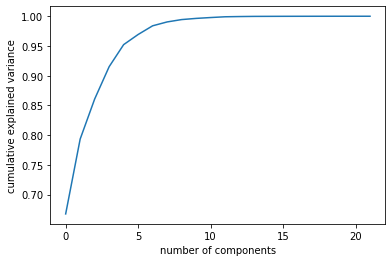

In [ ]:
pca = PCA().fit(ad)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')

In [ ]:
pca = PCA(n_components=10)
principalComponents = pca.fit_transform(ad)
PCA_components = pd.DataFrame(principalComponents, index=ad.index)
PCA_components

,,,,,0,1,2,3,4,5,6,7,8,9
user_id,username,user_screenname,modularity_class,anomaly,,,,,,,,,,
1232250616988262400,محد جواد رسولی,RasooliMj,158,1,-0.814,0.568,0.131,-0.147,0.009,-0.002,0.023,0.012,-0.081,0.089
872464367698272256,🇮🇷 Engineer,MjMj656565,158,1,-0.820,0.779,-0.124,-0.109,0.360,-0.121,-0.031,-0.046,0.022,-0.036
1143848825553117184,Tinix,Taningh1,5555,1,0.220,-0.305,0.225,-0.145,0.071,0.044,-0.034,0.013,-0.050,-0.001
989452221761904641,mehrdad🏳,refighe_bad,1375,1,0.058,0.027,0.050,-0.075,-0.114,-0.028,-0.107,-0.012,-0.015,0.006
2578250978,Seied Pourmousavi,sapourmousavi,158,1,0.784,-0.238,-0.081,0.004,-0.243,-0.026,0.090,-0.034,0.054,-0.009
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,5555,1,-0.504,-0.262,-0.381,0.019,-0.064,-0.108,0.032,-0.011,-0.008,0.021
1216418030793691136,Saturn,saturn_2281,5555,1,0.792,0.044,-0.084,-0.031,0.206,0.053,-0.029,0.033,-0.044,-0.012
1228943684437184512,Khatun,roghayehkhatun,5555,1,0.650,-0.276,-0.179,0.035,-0.129,0.253,-0.016,0.112,-0.056,-0.004


In [ ]:
PCA_components = PCA_components.rename(columns={0: 'pca_1', 1: 'pca_2', 2: 'pca_3', 3: 'pca_4', 4: 'pca_5', 5: 'pca_6', 6: 'pca_7', 7: 'pca_8', 8: 'pca_9', 9: 'pca_10'})
PCA_components['anomaly'] = PCA_components.index.get_level_values('anomaly') 
PCA_components

,,,,,pca_1,pca_2,pca_3,pca_4,pca_5,pca_6,pca_7,pca_8,pca_9,pca_10,anomaly
user_id,username,user_screenname,modularity_class,anomaly,,,,,,,,,,,
1232250616988262400,محد جواد رسولی,RasooliMj,158,1,-0.814,0.568,0.131,-0.147,0.009,-0.002,0.023,0.012,-0.081,0.089,1
872464367698272256,🇮🇷 Engineer,MjMj656565,158,1,-0.820,0.779,-0.124,-0.109,0.360,-0.121,-0.031,-0.046,0.022,-0.036,1
1143848825553117184,Tinix,Taningh1,5555,1,0.220,-0.305,0.225,-0.145,0.071,0.044,-0.034,0.013,-0.050,-0.001,1
989452221761904641,mehrdad🏳,refighe_bad,1375,1,0.058,0.027,0.050,-0.075,-0.114,-0.028,-0.107,-0.012,-0.015,0.006,1
2578250978,Seied Pourmousavi,sapourmousavi,158,1,0.784,-0.238,-0.081,0.004,-0.243,-0.026,0.090,-0.034,0.054,-0.009,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,5555,1,-0.504,-0.262,-0.381,0.019,-0.064,-0.108,0.032,-0.011,-0.008,0.021,1
1216418030793691136,Saturn,saturn_2281,5555,1,0.792,0.044,-0.084,-0.031,0.206,0.053,-0.029,0.033,-0.044,-0.012,1
1228943684437184512,Khatun,roghayehkhatun,5555,1,0.650,-0.276,-0.179,0.035,-0.129,0.253,-0.016,0.112,-0.056,-0.004,1


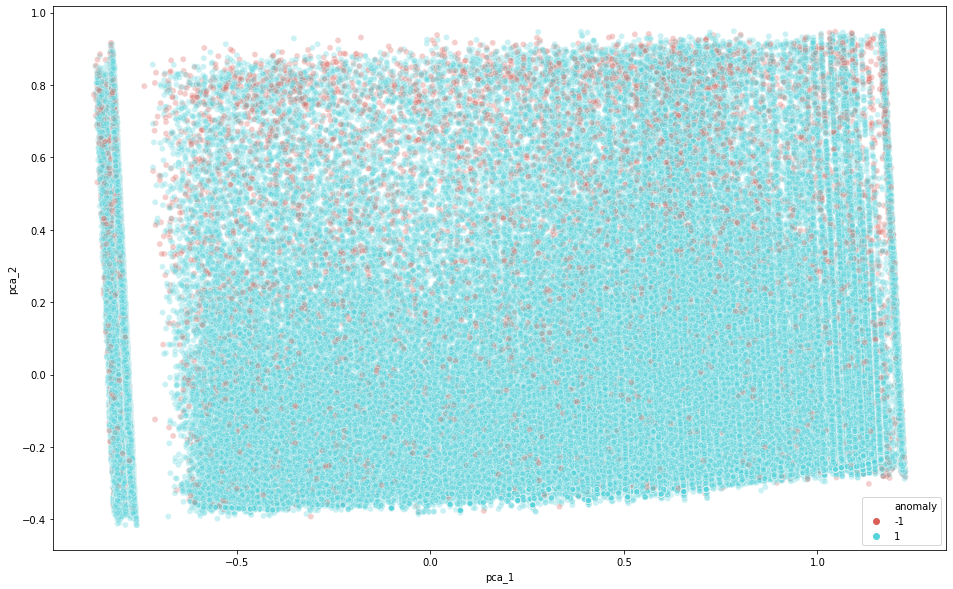

In [ ]:
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="pca_1", y="pca_2",
    hue="anomaly",
    palette=sns.color_palette("hls", 2),
    data=PCA_components,
    legend="full",
    alpha=0.3
)

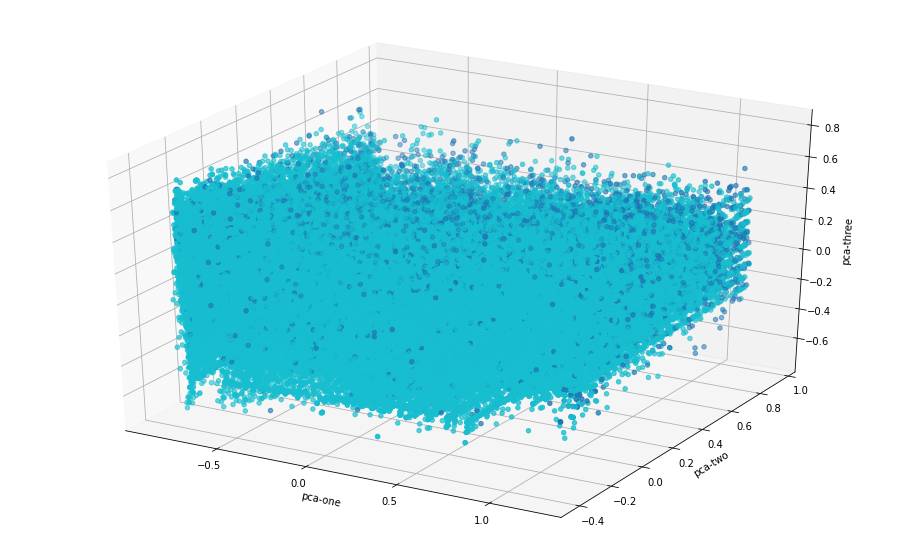

In [ ]:
ax = plt.figure(figsize=(16,10)).gca(projection='3d')
ax.scatter(
    xs=PCA_components["pca_1"], 
    ys=PCA_components["pca_2"],
    zs=PCA_components["pca_3"],
    c=PCA_components["anomaly"],
    cmap='tab10'
)
ax.set_xlabel('pca-one')
ax.set_ylabel('pca-two')
ax.set_zlabel('pca-three')
plt.show()

In [ ]:
ad.to_csv('anomaly_norm_data.csv')
shutil.copy("anomaly_norm_data.csv", "/content/drive/My Drive/twitter bot detection project")

'/content/drive/My Drive/twitter bot detection project/anomaly_norm_data.csv'

# **Features Correlation**

In [ ]:
df_corr = scls.corr()
df_corr

,followers_count,friends_count,statuses_count,favourites_count,listed_count,year_joined,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,names_avg_distance,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,description_length,pp_description_length,fave_per_tweet,fave_per_follower,followers_per_friends
followers_count,1.000,0.060,0.042,0.021,0.576,-0.035,0.012,-0.001,-0.003,-0.012,0.004,0.004,0.004,0.002,-0.000,0.000,0.000,0.028,0.027,-0.001,-0.002,0.344
friends_count,0.060,1.000,0.251,0.199,0.171,-0.047,0.081,-0.021,0.007,-0.024,0.103,0.101,-0.024,-0.073,-0.077,-0.071,-0.070,0.169,0.145,-0.002,-0.015,-0.002
statuses_count,0.042,0.251,1.000,0.400,0.275,-0.161,0.053,-0.037,0.009,-0.036,0.092,0.090,0.009,-0.044,-0.047,-0.043,-0.042,0.113,0.105,-0.010,0.007,0.012
favourites_count,0.021,0.199,0.400,1.000,0.069,-0.180,0.001,-0.079,-0.016,-0.081,0.097,0.099,-0.020,-0.131,-0.136,-0.127,-0.127,0.104,0.077,0.024,0.063,-0.002
listed_count,0.576,0.171,0.275,0.069,1.000,-0.105,0.033,-0.012,-0.003,-0.029,0.006,0.006,0.015,0.017,0.012,0.012,0.013,0.069,0.068,-0.003,-0.003,0.197
year_joined,-0.035,-0.047,-0.161,-0.180,-0.105,1.000,-0.023,0.182,0.061,0.236,0.011,0.009,-0.045,-0.045,-0.020,-0.025,-0.027,-0.037,-0.047,0.001,-0.016,-0.012
username_length,0.012,0.081,0.053,0.001,0.033,-0.023,1.000,0.162,0.055,-0.143,0.184,0.179,0.041,0.011,-0.053,-0.006,0.003,0.222,0.216,-0.009,-0.019,0.004
screenname_length,-0.001,-0.021,-0.037,-0.079,-0.012,0.182,0.162,1.000,-0.024,0.244,-0.016,-0.022,0.044,0.040,0.058,0.021,0.017,0.003,0.013,-0.004,-0.009,0.001
username_digits,-0.003,0.007,0.009,-0.016,-0.003,0.061,0.055,-0.024,1.000,0.109,0.011,0.007,0.012,0.106,0.082,0.114,0.116,0.000,0.001,-0.003,0.001,-0.001
screenname_digits,-0.012,-0.024,-0.036,-0.081,-0.029,0.236,-0.143,0.244,0.109,1.000,-0.008,-0.018,0.085,-0.012,0.101,-0.005,-0.007,-0.101,-0.093,-0.006,-0.003,-0.002


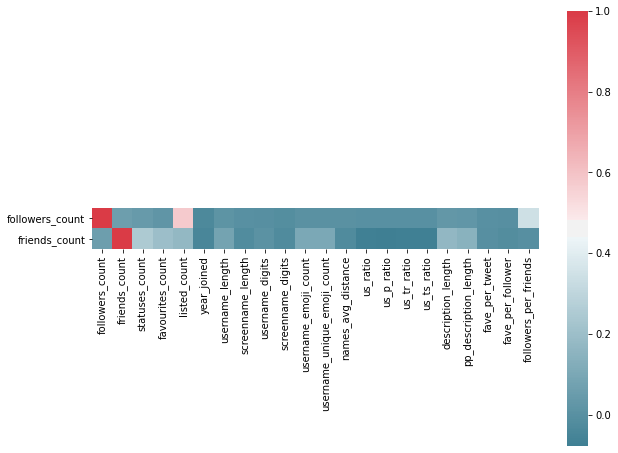

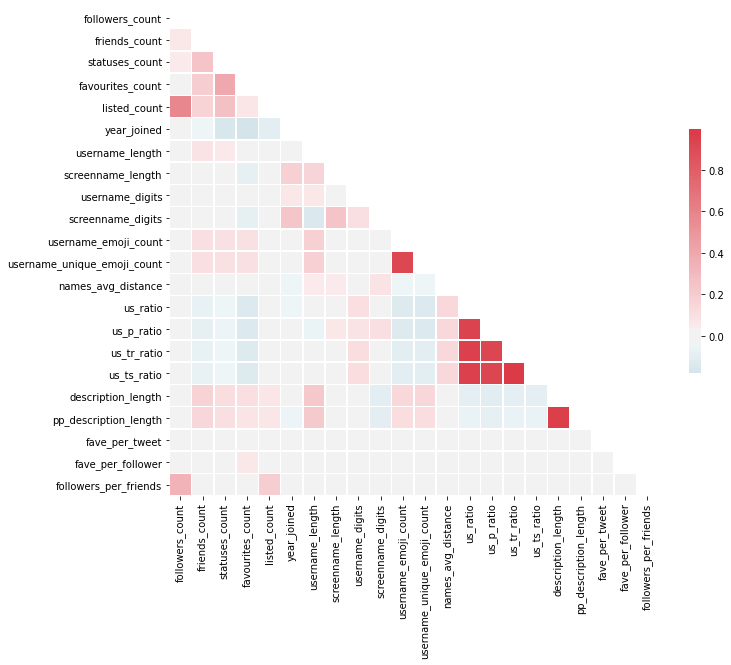

In [ ]:
f, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(df_corr.iloc[0:2,:], mask=np.zeros_like(df_corr.iloc[0:2,:], dtype=np.bool), cmap=sns.diverging_palette(220, 10, as_cmap=True),
            square=True, ax=ax)

mask = np.triu(np.ones_like(df_corr, dtype=np.bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(220, 10, as_cmap=True)
sns.heatmap(df_corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

# **Simple K-means with all numerical Features**

We run a simple k-means on our data using 1 to 10 clusters with maximum iteration number of 900 (default is 300) and we visualize the inertia of k-means for each model to find the optimum number of clusters using elbow method.

Elbow method means if the plot looks like an elbow the optimum number of clusters is the starting point of the plot that from that point the plot gets linear.

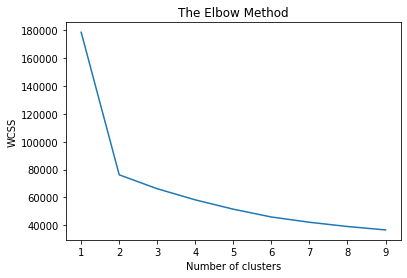

In [ ]:
wcss = []
for i in range(1,10):
    kmeans = KMeans(n_clusters=i,init='k-means++',max_iter=900,n_init=10,random_state=0)
    kmeans.fit(scls)
    wcss.append(kmeans.inertia_)
    
plt.plot(range(1,10),wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.savefig('elbow.png')
plt.show()

In [ ]:
kmeans = KMeans(n_clusters=6,max_iter=900)
kmeans.fit(scls)
centroids = kmeans.cluster_centers_

In [ ]:
idx = kmeans.predict(scls)
scls['prediction'] = kmeans.predict(scls)
scls

,,,,followers_count,friends_count,statuses_count,favourites_count,listed_count,year_joined,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,names_avg_distance,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,description_length,pp_description_length,fave_per_tweet,fave_per_follower,followers_per_friends,prediction
user_id,username,user_screenname,modularity_class,,,,,,,,,,,,,,,,,,,,,,,
1232250616988262400,محد جواد رسولی,RasooliMj,158,0.000,0.000,0.000,0.000,0.000,1.000,0.265,0.500,0.000,0.000,0.000,0.000,1.000,0.000,0.000,0.000,0.000,0.682,0.611,0.000,0.000,0.000,5
872464367698272256,🇮🇷 Engineer,MjMj656565,158,0.000,0.001,0.003,0.015,0.000,0.940,0.204,0.583,0.000,0.429,0.042,0.062,1.000,0.000,0.000,0.000,0.000,0.714,0.916,0.000,0.000,0.000,5
1143848825553117184,Tinix,Taningh1,5555,0.000,0.001,0.000,0.004,0.000,0.980,0.082,0.417,0.000,0.071,0.000,0.000,1.000,0.460,0.600,0.460,0.460,0.000,0.006,0.000,0.000,0.000,4
989452221761904641,mehrdad🏳,refighe_bad,1375,0.000,0.012,0.011,0.057,0.000,0.960,0.143,0.667,0.000,0.000,0.000,0.000,1.000,0.420,0.400,0.440,0.440,0.205,0.257,0.000,0.000,0.000,4
2578250978,Seied Pourmousavi,sapourmousavi,158,0.000,0.000,0.000,0.000,0.000,0.880,0.327,0.833,0.000,0.000,0.000,0.000,1.000,0.800,0.850,0.730,0.730,0.014,0.006,0.000,0.000,0.000,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,5555,0.000,0.002,0.003,0.016,0.000,0.980,0.286,1.000,0.000,0.286,0.000,0.000,1.000,0.130,0.140,0.130,0.130,0.064,0.042,0.000,0.000,0.000,3
1216418030793691136,Saturn,saturn_2281,5555,0.000,0.001,0.002,0.008,0.000,1.000,0.102,0.667,0.000,0.286,0.000,0.000,1.000,0.710,1.000,0.710,0.710,0.209,0.281,0.000,0.000,0.000,2
1228943684437184512,Khatun,roghayehkhatun,5555,0.000,0.000,0.000,0.000,0.000,1.000,0.102,0.917,0.000,0.000,0.000,0.000,1.000,0.600,1.000,0.600,0.600,0.014,0.006,0.000,0.000,0.000,4


In [ ]:
centroid_map = dict(zip(scls.index, centroids))

# **PCA**

[Text(0, 0.5, 'PCA3')]

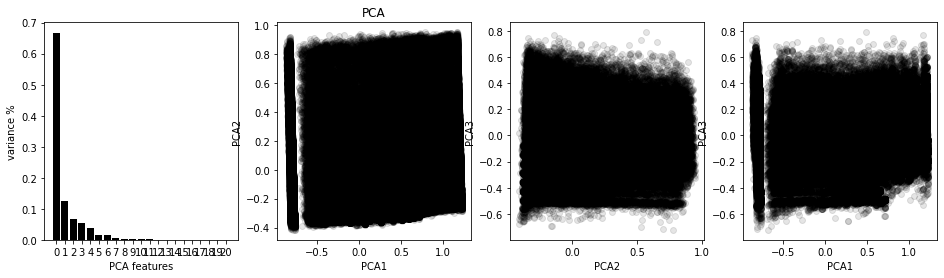

In [ ]:
plotX = scls.copy()

pca = PCA(n_components='mle')
principalComponents = pca.fit_transform(plotX)
PCA_components = pd.DataFrame(principalComponents, index=plotX.index)

# Plot the explained variances
features = range(pca.n_components_)

fig,ax = plt.subplots(1,4, figsize=(16,4))

ax[0].bar(features, pca.explained_variance_ratio_, color='black')
ax[0].set(xlabel = 'PCA features')
ax[0].set(ylabel = 'variance %')
ax[0].set(xticks = features)

ax[1].scatter(PCA_components[0], PCA_components[1], alpha=.1, color='black')
ax[1].set(xlabel = 'PCA1')
ax[1].set(ylabel = 'PCA2')
ax[1].set(title='PCA')

ax[2].scatter(PCA_components[1], PCA_components[2], alpha=.1, color='black')
ax[2].set(xlabel = 'PCA2')
ax[2].set(ylabel = 'PCA3')

ax[3].scatter(PCA_components[0], PCA_components[2], alpha=.1, color='black')
ax[3].set(xlabel = 'PCA1')
ax[3].set(ylabel = 'PCA3')


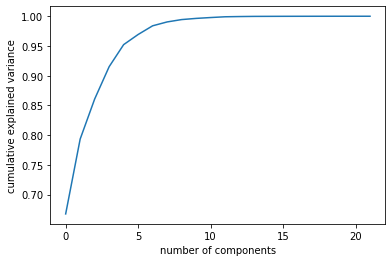

In [ ]:
pca = PCA().fit(plotX)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');

In [ ]:
pca = PCA(n_components=10)
principalComponents = pca.fit_transform(plotX)
PCA_components = pd.DataFrame(principalComponents, index=plotX.index)
PCA_components

,,,,0,1,2,3,4,5,6,7,8,9
user_id,username,user_screenname,modularity_class,,,,,,,,,,
1232250616988262400,محد جواد رسولی,RasooliMj,158,-0.814,0.568,0.131,-0.147,0.009,-0.002,0.023,0.012,-0.081,0.089
872464367698272256,🇮🇷 Engineer,MjMj656565,158,-0.820,0.779,-0.124,-0.109,0.360,-0.121,-0.031,-0.046,0.022,-0.036
1143848825553117184,Tinix,Taningh1,5555,0.220,-0.305,0.225,-0.145,0.071,0.044,-0.034,0.013,-0.050,-0.001
989452221761904641,mehrdad🏳,refighe_bad,1375,0.058,0.027,0.050,-0.075,-0.114,-0.028,-0.107,-0.012,-0.015,0.006
2578250978,Seied Pourmousavi,sapourmousavi,158,0.784,-0.238,-0.081,0.004,-0.243,-0.026,0.090,-0.034,0.054,-0.009
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,5555,-0.504,-0.262,-0.381,0.019,-0.064,-0.108,0.032,-0.011,-0.008,0.021
1216418030793691136,Saturn,saturn_2281,5555,0.792,0.044,-0.084,-0.031,0.206,0.053,-0.029,0.033,-0.044,-0.012
1228943684437184512,Khatun,roghayehkhatun,5555,0.650,-0.276,-0.179,0.035,-0.129,0.253,-0.016,0.112,-0.056,-0.004


# **Simple K-means with PCA**

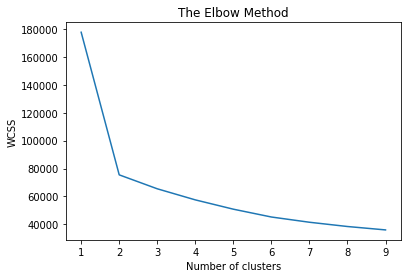

In [ ]:
wcss = []
for i in range(1,10):
    kmeans = KMeans(n_clusters=i,init='k-means++',max_iter=900,n_init=10,random_state=0)
    kmeans.fit(PCA_components)
    wcss.append(kmeans.inertia_)
    
plt.plot(range(1,10),wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.savefig('elbow.png')
plt.show()

In [ ]:
kmeans = KMeans(n_clusters=6,max_iter=900)
kp = PCA_components.copy()
kmeans.fit(kp)
centroids = kmeans.cluster_centers_

In [ ]:
idx = kmeans.predict(kp)
kp['prediction'] = kmeans.predict(kp)
kp

,,,,0,1,2,3,4,5,6,7,8,9,prediction
user_id,username,user_screenname,modularity_class,,,,,,,,,,,
1232250616988262400,محد جواد رسولی,RasooliMj,158,-0.814,0.568,0.131,-0.147,0.009,-0.002,0.023,0.012,-0.081,0.089,1
872464367698272256,🇮🇷 Engineer,MjMj656565,158,-0.820,0.779,-0.124,-0.109,0.360,-0.121,-0.031,-0.046,0.022,-0.036,1
1143848825553117184,Tinix,Taningh1,5555,0.220,-0.305,0.225,-0.145,0.071,0.044,-0.034,0.013,-0.050,-0.001,3
989452221761904641,mehrdad🏳,refighe_bad,1375,0.058,0.027,0.050,-0.075,-0.114,-0.028,-0.107,-0.012,-0.015,0.006,3
2578250978,Seied Pourmousavi,sapourmousavi,158,0.784,-0.238,-0.081,0.004,-0.243,-0.026,0.090,-0.034,0.054,-0.009,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,5555,-0.504,-0.262,-0.381,0.019,-0.064,-0.108,0.032,-0.011,-0.008,0.021,4
1216418030793691136,Saturn,saturn_2281,5555,0.792,0.044,-0.084,-0.031,0.206,0.053,-0.029,0.033,-0.044,-0.012,2
1228943684437184512,Khatun,roghayehkhatun,5555,0.650,-0.276,-0.179,0.035,-0.129,0.253,-0.016,0.112,-0.056,-0.004,3


In [ ]:
kp = kp.rename(columns={0: 'pca_1', 1: 'pca_2', 2: 'pca_3', 3: 'pca_4', 4: 'pca_5', 5: 'pca_6', 6: 'pca_7', 7: 'pca_8', 8: 'pca_9', 9: 'pca_10'})
kp.columns.values

array(['pca_1', 'pca_2', 'pca_3', 'pca_4', 'pca_5', 'pca_6', 'pca_7',
       'pca_8', 'pca_9', 'pca_10', 'prediction'], dtype=object)

In [ ]:
features = ['pca_1', 'pca_2', 'pca_3', 'pca_4', 'pca_5', 'pca_6']

fig = px.scatter_matrix(
    kp,
    dimensions=features,
    color="prediction"
)
fig.update_traces(diagonal_visible=False)
fig.show()

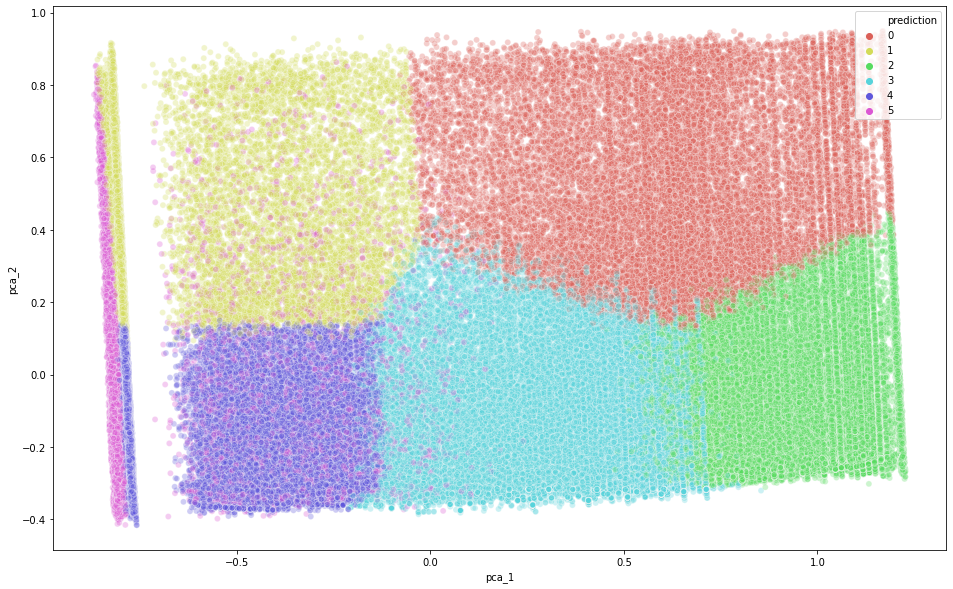

In [ ]:
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="pca_1", y="pca_2",
    hue="prediction",
    palette=sns.color_palette("hls", 6),
    data=kp,
    legend="full",
    alpha=0.3
)

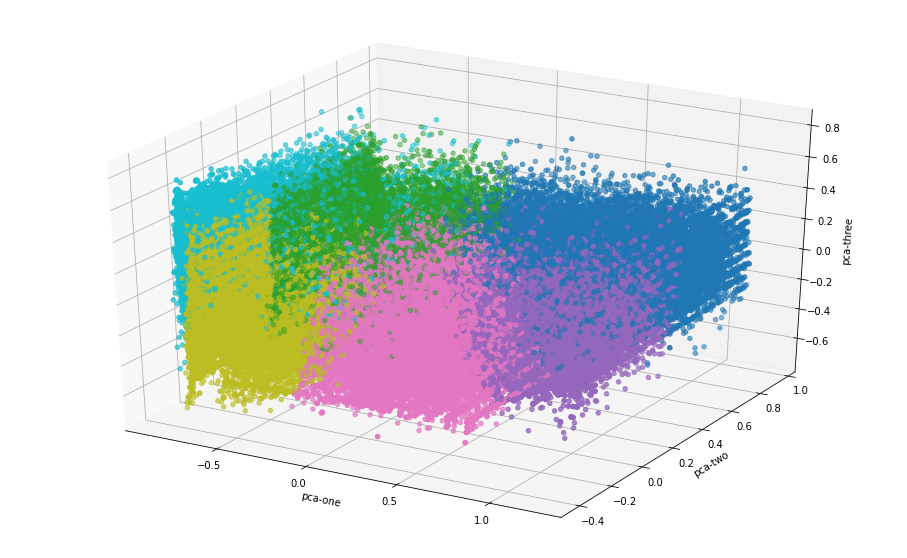

In [ ]:
ax = plt.figure(figsize=(16,10)).gca(projection='3d')
ax.scatter(
    xs=kp["pca_1"], 
    ys=kp["pca_2"],
    zs=kp["pca_3"],
    c=kp["prediction"],
    cmap='tab10'
)
ax.set_xlabel('pca-one')
ax.set_ylabel('pca-two')
ax.set_zlabel('pca-three')
plt.show()

In [ ]:
kp.to_csv('pca.csv')
shutil.copy("pca.csv", "/content/drive/My Drive/twitter bot detection project")

'/content/drive/My Drive/twitter bot detection project/pca.csv'

# **Simple K-means with t-SNE on PCA**

**Computing t-SNE 2D Values**

t-SNE (t-Distributed Stochastic Neighbor Embedding) is nonlinear dimensionality reduction technique in which interrelated high dimensional data (usually hundreds or thousands of variables) is mapped into low-dimensional data (like 2 or 3 variables) while preserving the significant structure (relationship among the data points in different variables) of original high dimensional data.

The resulting reduced 2 or 3-dimensional data represents the structure of high dimensional data and easy to visualize on the scatter plot. The proximal samples will be placed together and dissimilar samples at greater distances. t-SNE is mostly used for the visualization purposes only and not for detailed quantitative analysis.

Unlike PCA, t-SNE can be applied and work better with both linear and nonlinear well-clustered datasets and produces more meaningful clustering.

t-SNE is a stochastic method and produces slightly different embeddings if run multiple times. These different results could affect the numeric values on the axis but do not affect the clustering of the points. Therefore, t-SNE can be run several times to get the embeddings with the smallest Kullback–Leibler (KL) divergence. The run with the smallest KL could have the greatest variation.

If the original high-dimensional dataset contains larger number variables , it is highly recommended first to reduce the variables to small numbers (e.g. 20 to 50) using another dimensionality reduction technique (e.g. PCA) for t-SNE. It will help to speed up the t-SNE computation time and suppresses the noisy data points. Additionally, you can also use other variants of t-SNE such as Fast Fourier Transform-accelerated Interpolation-based t-SNE (FIt-SNE) for larger datasets (Linderman et al., 2019).

In t-SNE, a most important parameter called perplexity, which measures the effective number of neighbors, controls the trade-off between global high-dimensional and local low-dimensional space, and possible to produce a more defined structure of the clusters. The number of variables in the original high dimensional data determines the perplexity parameter (standard range 10-100).

While t-SNE is good in visualizing the well-separated clusters, most of the time it fails to preserve the global geometry of the data. Kobak et al., 2019 suggested keeping large perplexity parameter (n/100; where n is the number of cells) for preserving the global geometry.

In addition to the perplexity parameter, other parameters such as the number of iterations, learning rate (set n/12 or 200 whichever is greater), and early exaggeration factor can also affect the visualization and should be optimized for larger datasets (Kobak et al., 2019).

In [ ]:
time_start = time.time()

tsne = TSNE(n_components=2, verbose=1, perplexity=50, n_iter=600)
tsne_results = tsne.fit_transform(PCA_components)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 225086 samples in 0.945s...
[t-SNE] Computed neighbors for 225086 samples in 122.316s...
[t-SNE] Computed conditional probabilities for sample 1000 / 225086
[t-SNE] Computed conditional probabilities for sample 2000 / 225086
[t-SNE] Computed conditional probabilities for sample 3000 / 225086
[t-SNE] Computed conditional probabilities for sample 4000 / 225086
[t-SNE] Computed conditional probabilities for sample 5000 / 225086
[t-SNE] Computed conditional probabilities for sample 6000 / 225086
[t-SNE] Computed conditional probabilities for sample 7000 / 225086
[t-SNE] Computed conditional probabilities for sample 8000 / 225086
[t-SNE] Computed conditional probabilities for sample 9000 / 225086
[t-SNE] Computed conditional probabilities for sample 10000 / 225086
[t-SNE] Computed conditional probabilities for sample 11000 / 225086
[t-SNE] Computed conditional probabilities for sample 12000 / 225086
[t-SNE] Computed conditional prob

In [ ]:
tsne_results = np.load('/content/drive/My Drive/twitter bot detection project/users_projection.npy')

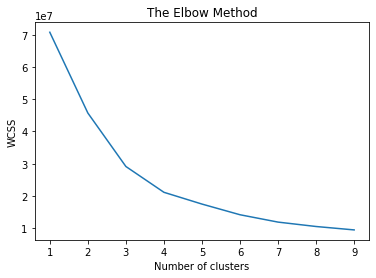

In [ ]:
wcss = []
for i in range(1,10):
    kmeans = KMeans(n_clusters=i,init='k-means++',max_iter=900,n_init=10,random_state=0)
    kmeans.fit(tsne_results)
    wcss.append(kmeans.inertia_)
    
plt.plot(range(1,10),wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.savefig('elbow.png')
plt.show()

In [ ]:
TSNE_components = pd.DataFrame(tsne_results, index=PCA_components.index)
TSNE_components

,,,,0,1
user_id,username,user_screenname,modularity_class,,
1232250616988262400,محد جواد رسولی,RasooliMj,158,-16.649,7.385
872464367698272256,🇮🇷 Engineer,MjMj656565,158,-6.003,-8.224
1143848825553117184,Tinix,Taningh1,5555,11.760,1.997
989452221761904641,mehrdad🏳,refighe_bad,1375,4.412,4.592
2578250978,Seied Pourmousavi,sapourmousavi,158,-1.460,4.235
...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,5555,21.855,-13.071
1216418030793691136,Saturn,saturn_2281,5555,6.696,-5.986
1228943684437184512,Khatun,roghayehkhatun,5555,-16.134,16.779


In [ ]:
kmeans = KMeans(n_clusters=6,max_iter=900)
kt = TSNE_components.copy()
kmeans.fit(kt)
centroids = kmeans.cluster_centers_

In [ ]:
idx = kmeans.predict(kt)
kt['prediction'] = kmeans.predict(kt)
kt

,,,,0,1,prediction
user_id,username,user_screenname,modularity_class,,,
1232250616988262400,محد جواد رسولی,RasooliMj,158,-16.649,7.385,1
872464367698272256,🇮🇷 Engineer,MjMj656565,158,-6.003,-8.224,3
1143848825553117184,Tinix,Taningh1,5555,11.760,1.997,0
989452221761904641,mehrdad🏳,refighe_bad,1375,4.412,4.592,5
2578250978,Seied Pourmousavi,sapourmousavi,158,-1.460,4.235,5
...,...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,5555,21.855,-13.071,4
1216418030793691136,Saturn,saturn_2281,5555,6.696,-5.986,5
1228943684437184512,Khatun,roghayehkhatun,5555,-16.134,16.779,2


In [ ]:
kt = kt.rename(columns={0: 't-SNE_1', 1: 't-SNE_2'})

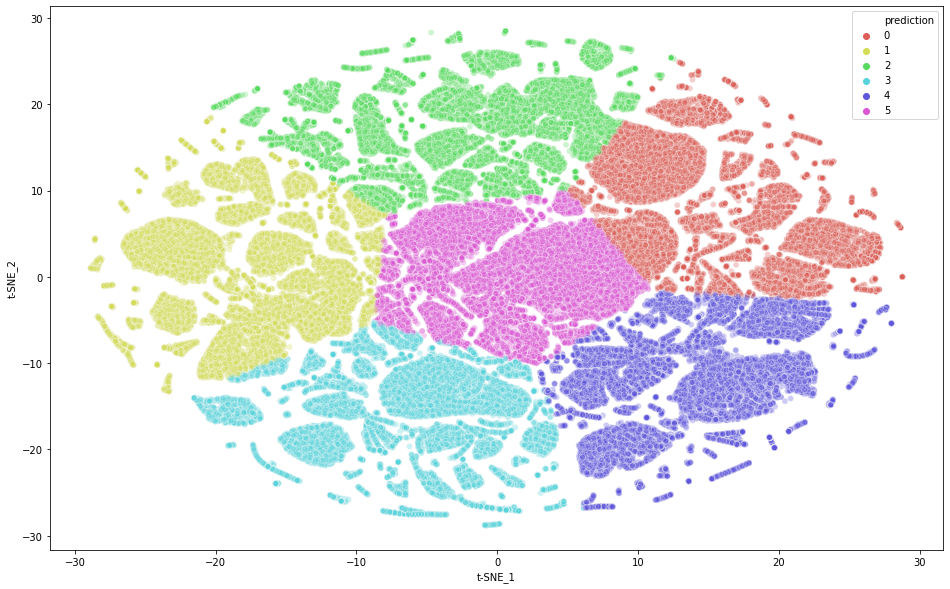

In [ ]:
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="t-SNE_1", y="t-SNE_2",
    hue="prediction",
    palette=sns.color_palette("hls", 6),
    data=kt,
    legend="full",
    alpha=0.3
)

In [ ]:
# np.save('users_projection.npy', tsne_results)
kt.to_csv('tsne_on_pca.csv')
# shutil.copy("users_projection.npy", "/content/drive/My Drive/twitter bot detection project")
shutil.copy("tsne_on_pca.csv", "/content/drive/My Drive/twitter bot detection project")

'/content/drive/My Drive/twitter bot detection project/tsne_on_pca.csv'

# **Kernelized K-means**

In [ ]:
wcss = []
for i in range(1,10):
    kmeans = SpectralClustering(n_clusters=i, affinity='nearest_neighbors', assign_labels='kmeans')
    kmeans.fit(PCA_components)
    wcss.append(kmeans.inertia_)
    
plt.plot(range(1,10),wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.savefig('elbow.png')
plt.show()

/usr/local/lib/python3.6/dist-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



In [ ]:
model = SpectralClustering(n_clusters=2, affinity='nearest_neighbors', assign_labels='kmeans')
labels = model.fit_predict(scls)

# **DBSCAN & PCA**

In [ ]:
dls = scls.copy()

pca = PCA(n_components=10)
principalComponents = pca.fit_transform(dls)
PCA_components = pd.DataFrame(principalComponents, index=dls.index)
PCA_components

,,,,0,1,2,3,4,5,6,7,8,9
user_id,username,user_screenname,modularity_class,,,,,,,,,,
1232250616988262400,محد جواد رسولی,RasooliMj,158,-0.814296,0.568232,0.130935,-0.146849,0.008884,-0.001717,0.023288,0.011693,-0.081176,0.088706
872464367698272256,🇮🇷 Engineer,MjMj656565,158,-0.820286,0.778521,-0.123620,-0.109304,0.359567,-0.120870,-0.030594,-0.045694,0.022347,-0.036328
1143848825553117184,Tinix,Taningh1,5555,0.220444,-0.305285,0.224638,-0.145304,0.071258,0.044308,-0.033961,0.012592,-0.049638,-0.000605
989452221761904641,mehrdad🏳,refighe_bad,1375,0.057963,0.027432,0.049517,-0.074523,-0.113774,-0.027556,-0.106943,-0.012352,-0.015408,0.005612
2578250978,Seied Pourmousavi,sapourmousavi,158,0.784424,-0.237705,-0.080622,0.003740,-0.243099,-0.025794,0.090380,-0.033666,0.054438,-0.009017
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,5555,-0.504174,-0.261538,-0.381012,0.019473,-0.064092,-0.107664,0.032162,-0.011177,-0.007758,0.020839
1216418030793691136,Saturn,saturn_2281,5555,0.791555,0.044174,-0.084153,-0.030861,0.206426,0.053352,-0.029437,0.033374,-0.044396,-0.012471
1228943684437184512,Khatun,roghayehkhatun,5555,0.649950,-0.275999,-0.178757,0.035271,-0.129046,0.253318,-0.015564,0.112101,-0.055539,-0.004106


In [ ]:
# Compute DBSCAN
db = DBSCAN(eps=0.3, min_samples=10).fit(PCA_components)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Homogeneity: %0.3f" % metrics.homogeneity_score(labels_true, labels))
print("Completeness: %0.3f" % metrics.completeness_score(labels_true, labels))
print("V-measure: %0.3f" % metrics.v_measure_score(labels_true, labels))
print("Adjusted Rand Index: %0.3f"
      % metrics.adjusted_rand_score(labels_true, labels))
print("Adjusted Mutual Information: %0.3f"
      % metrics.adjusted_mutual_info_score(labels_true, labels))
print("Silhouette Coefficient: %0.3f"
      % metrics.silhouette_score(X, labels))

In [ ]:
# Black removed and is used for noise instead.
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    xy = PCA_components[class_member_mask & core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)

    xy = PCA_components[class_member_mask & ~core_samples_mask]
    plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=6)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

# **Classification**

In [ ]:
ktc = kt.copy()
kpc = kp.copy()
adc = ad.copy()

ktc = ktc.rename(columns={'prediction':'tsne_clusters'})
ktc = ktc[['tsne_clusters']]
kpc = kpc.rename(columns={'prediction':'pca_clusters'})
kpc = kpc[['pca_clusters']]
adc['anomaly_class'] = adc.index.get_level_values('anomaly') 
adc = adc[['anomaly_class']]
adc.index = adc.index.droplevel(4)

In [ ]:
merged = ktc.merge(kpc,on='user_id').merge(adc,on='user_id')
merged

,tsne_clusters,pca_clusters,anomaly_class
user_id,,,
1232250616988262400,1,1,1
872464367698272256,3,1,1
1143848825553117184,0,3,1
989452221761904641,5,3,1
2578250978,5,2,1
...,...,...,...
1144772303173148672,4,4,1
1216418030793691136,5,2,1
1228943684437184512,2,3,1


In [ ]:
final = data.join(merged, on='user_id')
final

,user_id,username,user_screenname,location,description,preprocessed_description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,year_joined,default_profile,default_profile_image,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,username_decoded_emojis,names_pp,name_changed,names_avg_distance,description_decoded_emojis,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,username_elong,screenname_elong,description_length,pp_description_length,has_url,fave_per_tweet,fave_per_follower,followers_per_friends,username_lang,description_lang,modularity_class,community,tsne_clusters,pca_clusters,anomaly_class
0,1232250616988262400,محد جواد رسولی,RasooliMj,NaN,تیم اجرایی تلویزیون اینترنتی شرجی https://t.co...,تیم اجرایی تلویزیون اینترنتی شرجی مدیر اجرایی ...,56,111,38,45,False,False,0,2020-02-25 10:27:04,2020,True,False,14,9,0,0,0,0,NaN,RasooliMj,False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,151,102,True,1.180,0.800,0.500,farsi,farsi,158,opposer,1,1,1
1,872464367698272256,🇮🇷 Engineer,MjMj656565,Islamic Republic of Iran,‏‏‏‏کارشناس ارشد مکانیک ساخت و تولید.\nارزشی ا...,کارشناس ارشد مکانیک ساخت و تولید ارزشی انقلاب...,243,292,10955,17948,False,False,1,2017-06-07 14:44:49,2017,True,False,11,10,0,6,1,1,{'iran'},{'MjMj656565'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,158,153,False,1.640,73.860,0.830,english,farsi,158,opposer,3,1,1
2,1143848825553117184,Tinix,Taningh1,NaN,𓃠,𓃠,214,179,400,4202,False,False,0,2019-06-26 11:49:46,2019,True,False,5,8,0,1,0,0,NaN,"{'taningh1', 'Taningh1'}",True,100.000,NaN,46.000,60.000,46.000,46.000,False,False,1,1,False,10.510,19.640,1.200,english,others,5555,not_identified,0,3,1
3,989452221761904641,mehrdad🏳,refighe_bad,depression,"Not much better than me,but no one like me ...",not much better than me but no one like me,3337,3317,38915,66501,False,False,2,2018-04-26 10:32:47,2018,True,False,8,11,0,0,0,0,NaN,{'refighe_bad'},False,100.000,NaN,42.000,40.000,44.000,44.000,False,False,46,43,False,1.710,19.930,1.010,english,english,1375,opoosers_bots,5,3,1
4,2578250978,Seied Pourmousavi,sapourmousavi,NaN,NaN,NaN,5,127,72,100,False,False,0,2014-06-20 07:42:27,2014,True,False,17,13,0,0,0,0,NaN,{'sapourmousavi'},False,100.000,NaN,80.000,85.000,73.000,73.000,False,False,0,3,False,1.390,20.000,0.040,english,english,158,opposer,5,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
225081,1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,ایرانشهر,‏‏‏‏‏‏‏‏‏نریمان,نریمان,227,507,12625,18561,False,False,0,2019-06-29 00:59:20,2019,True,False,15,15,0,4,0,0,NaN,{'2xSp0cT9EYHH2uq'},False,100.000,NaN,13.000,14.000,13.000,13.000,False,False,15,7,False,1.470,81.770,0.450,english,farsi,5555,not_identified,4,4,1
225082,1216418030793691136,Saturn,saturn_2281,Shiraz,make a wish to have sth better than what u lost,make a wish to have sth better than what u lost,317,247,7696,9870,False,False,0,2020-01-12 17:54:05,2020,True,False,6,11,0,4,0,0,NaN,{'saturn_2281'},False,100.000,NaN,71.000,100.000,71.000,71.000,False,False,47,47,False,1.280,31.140,1.280,english,english,5555,not_identified,5,2,1
225083,1228943684437184512,Khatun,roghayehkhatun,NaN,NaN,NaN,23,47,40,132,False,False,0,2020-02-16 07:26:50,2020,True,False,6,14,0,0,0,0,NaN,{'roghayehkhatun'},False,100.000,NaN,60.000,100.000,60.000,60.000,False,False,0,3,False,3.300,5.740,0.490,english,english,5555,not_identified,2,3,1
225084,1221843535894319104,AmmareAli,ali_ammare,NaN,NaN,NaN,18,0,210,952,False,False,0,2020-01-27 17:13:06,2020,True,False,9,10,0,0,0,0,NaN,{'ali_ammare'},False,100.000,NaN,63.000,80.000,63.000,63.000,False,False,0,3,False,4.530,52.890,18.000,english,english,1118,fans,5,3,1


In [ ]:
final.to_csv('final_users_refined_com_pp_labeled.csv')
shutil.copy("final_users_refined_com_pp_labeled.csv", "/content/drive/My Drive/twitter bot detection project")

'/content/drive/My Drive/twitter bot detection project/final_users_refined_com_pp_labeled.csv'

# **Encoding Categorical Features**

We use Category Encoders to improve model performance when we have nominal or ordinal data that may provide value.

1. For nominal columns OneHot, Hashing, LeaveOneOut, and Target encoding. Avoid OneHot for high cardinality columns and decision tree-based algorithms.

2. For ordinal columns Ordinal (Integer), Binary, OneHot, LeaveOneOut, and Target. 
Helmert, Sum, BackwardDifference and Polynomial are less likely to be helpful.

3. For regression tasks, Target and LeaveOneOut probably won’t work well.


**Classic Encoders**
The first group of five classic encoders can be seen on a continuum of embedding information in one column (Ordinal) up to k columns (OneHot).

1. **Ordinal** — convert string labels to integer values 1 through k. Ordinal.
2. **OneHot** — one column for each value to compare vs. all other values. Nominal, ordinal.
3. **Binary** — convert each integer to binary digits. Each binary digit gets one column. Some info loss but fewer dimensions. Ordinal.
4. **BaseN** — Ordinal, Binary, or higher encoding. Nominal, ordinal. Doesn’t add much functionality. Probably avoid.
5. **Hashing** — Like OneHot but fewer dimensions, some info loss due to collisions. Nominal, ordinal.
6. **Sum** — Just like OneHot except one value is held constant and encoded as -1 across all columns.


**Contrast Encoders**
The five contrast encoders all have multiple issues that I argue make them unlikely to be useful for machine learning. They all output one column for each value found in a column. Their stated intents are below.

1. **Helmert (reverse)** — The mean of the dependent variable for a level is compared to the mean of the dependent variable over all previous levels.
2. **Backward Difference** — the mean of the dependent variable for a level is compared with the mean of the dependent variable for the prior level.
3. **Polynomial** — orthogonal polynomial contrasts. The coefficients taken on by polynomial coding for k=4 levels are the linear, quadratic, and cubic trends in the categorical variable.

**Bayesian Encoders**
The Bayesian encoders use information from the dependent variable in their encodings. They output one column and can work well with high cardinality data.

1. **Target** — use the mean of the DV, must take steps to avoid overfitting/ response leakage. Nominal, ordinal. For classification tasks.
2. **LeaveOneOut** — similar to target but avoids contamination. Nominal, ordinal. For classification tasks.
3. **WeightOfEvidence** — added in v1.3. Not documented in the docs as of April 11, 2019. The method is explained in this post.
4. **James-Stein** — forthcoming in v1.4. Described in the code here.
5. **M-estimator** — forthcoming in v1.4. Described in the code here. Simplified target encoder.


**Encoding using replacing values (unequal weights)**

Automated Method

In [ ]:
labels = fcls['username_lang'].astype('category').cat.categories.tolist()
replace_map_comp = {'username_lang' : {k: v for k,v in zip(labels,list(range(1,len(labels)+1)))}}

print(replace_map_comp)
fcls.replace(replace_map_comp, inplace=True)

{'username_lang': {'english': 1, 'farsi': 2, 'others': 3}}


Manual Method

In [ ]:
replace_map = {'username_lang': {'english': 1}}
fcls.replace(replace_map, inplace=True)

**Encoding Using Label Encoding (unequal weights)**

First Method

In [ ]:
fcls['username_lang'] = fcls['username_lang'].cat.codes
fcls['Farsi'] = np.where(fcls['username_lang'].str.contains('farsi'), 1, 0) #encode a bunch of categories within a feature to some numeric value and encode all the other categories to some other numeric value.

Second Method

In [ ]:
lb_make = LabelEncoder()
fcls['username_lang'] = lb_make.fit_transform(fcls['username_lang'])

**Encoding Using One-hot => solves the problem of unequal weights but leads to high dimensional dataset**

First Method

In [ ]:
fcls_onehot = fcls.copy()
fcls_onehot = pd.get_dummies(fcls_onehot, columns=['username_lang'], prefix = ['username'])
fcls_onehot = pd.get_dummies(fcls_onehot, columns=['description_lang'], prefix = ['description'])
fcls_onehot

Second Method

In [ ]:
lb = LabelBinarizer()
lb_results = lb.fit_transform(fcls['username_lang'])
lb_results_df = pd.DataFrame(lb_results, columns=lb.classes_)
result_df = pd.concat([fcls, lb_results_df], axis=1)

**Encoding using Binary Encoding => fewer dimensions than one-hot (curse of dimensionality)**

In [ ]:
encoder = ce.BinaryEncoder(cols=['username_lang'])
df_binary = encoder.fit_transform(fcls)
df_binary

**Encoding Using Backward Difference Encoding**

In [ ]:
encoder = ce.BackwardDifferenceEncoder(cols=['username_lang'])
df_bd = encoder.fit_transform(fcls)
df_bd

**Encoding using Effect Encoder => The row containing only 0s in dummy encoding is encoded as -1 in effect encoding.**

In [ ]:
encoder=ce.sum_coding.SumEncoder(cols='username_lang')
df_se = encoder.fit_transform(data)
df_se

# **botometer**

In [ ]:
path = '/content/drive/My Drive/twitter bot detection project/refined_users_pp.csv'
data = pd.read_csv(path)
data = data.drop(columns=['Unnamed: 0'])
data

,user_id,username,user_screenname,location,description,preprocessed_description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,year_joined,default_profile,default_profile_image,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,username_decoded_emojis,names_pp,name_changed,names_avg_distance,description_decoded_emojis,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,username_elong,screenname_elong,description_length,pp_description_length,has_url,fave_per_tweet,fave_per_follower,followers_per_friends,username_lang,description_lang
0,1232250616988262400,محد جواد رسولی,RasooliMj,NaN,تیم اجرایی تلویزیون اینترنتی شرجی https://t.co...,تیم اجرایی تلویزیون اینترنتی شرجی مدیر اجرایی ...,56,111,38,45,False,False,0,2020-02-25 10:27:04,2020,True,False,14,9,0,0,0,0,NaN,RasooliMj,False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,151,102,True,1.180,0.800,0.500,farsi,farsi
1,872464367698272256,🇮🇷 Engineer,MjMj656565,Islamic Republic of Iran,‏‏‏‏کارشناس ارشد مکانیک ساخت و تولید.\nارزشی ا...,کارشناس ارشد مکانیک ساخت و تولید ارزشی انقلاب...,243,292,10955,17948,False,False,1,2017-06-07 14:44:49,2017,True,False,11,10,0,6,1,1,{'iran'},{'MjMj656565'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,158,153,False,1.640,73.860,0.830,english,farsi
2,1143848825553117184,Tinix,Taningh1,NaN,𓃠,𓃠,214,179,400,4202,False,False,0,2019-06-26 11:49:46,2019,True,False,5,8,0,1,0,0,NaN,"{'taningh1', 'Taningh1'}",True,100.000,NaN,46.000,60.000,46.000,46.000,False,False,1,1,False,10.510,19.640,1.200,english,others
3,989452221761904641,mehrdad🏳,refighe_bad,depression,"Not much better than me,but no one like me ...",not much better than me but no one like me,3337,3317,38915,66501,False,False,2,2018-04-26 10:32:47,2018,True,False,8,11,0,0,0,0,NaN,{'refighe_bad'},False,100.000,NaN,42.000,40.000,44.000,44.000,False,False,46,43,False,1.710,19.930,1.010,english,english
4,2578250978,Seied Pourmousavi,sapourmousavi,NaN,NaN,NaN,5,127,72,100,False,False,0,2014-06-20 07:42:27,2014,True,False,17,13,0,0,0,0,NaN,{'sapourmousavi'},False,100.000,NaN,80.000,85.000,73.000,73.000,False,False,0,3,False,1.390,20.000,0.040,english,english
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
229564,1144772303173148672,Nariman Masoudi,2xSp0cT9EYHH2uq,ایرانشهر,‏‏‏‏‏‏‏‏‏نریمان,نریمان,227,507,12625,18561,False,False,0,2019-06-29 00:59:20,2019,True,False,15,15,0,4,0,0,NaN,{'2xSp0cT9EYHH2uq'},False,100.000,NaN,13.000,14.000,13.000,13.000,False,False,15,7,False,1.470,81.770,0.450,english,farsi
229565,1216418030793691136,Saturn,saturn_2281,Shiraz,make a wish to have sth better than what u lost,make a wish to have sth better than what u lost,317,247,7696,9870,False,False,0,2020-01-12 17:54:05,2020,True,False,6,11,0,4,0,0,NaN,{'saturn_2281'},False,100.000,NaN,71.000,100.000,71.000,71.000,False,False,47,47,False,1.280,31.140,1.280,english,english
229566,1228943684437184512,Khatun,roghayehkhatun,NaN,NaN,NaN,23,47,40,132,False,False,0,2020-02-16 07:26:50,2020,True,False,6,14,0,0,0,0,NaN,{'roghayehkhatun'},False,100.000,NaN,60.000,100.000,60.000,60.000,False,False,0,3,False,3.300,5.740,0.490,english,english
229567,1221843535894319104,AmmareAli,ali_ammare,NaN,NaN,NaN,18,0,210,952,False,False,0,2020-01-27 17:13:06,2020,True,False,9,10,0,0,0,0,NaN,{'ali_ammare'},False,100.000,NaN,63.000,80.000,63.000,63.000,False,False,0,3,False,4.530,52.890,18.000,english,english


**Evaluation**

In [ ]:
ham = data.loc[(data['username_digits']==0) & (data['screenname_digits']==0) & (data['username_emoji_count']==0) & (data['username_lang']=='farsi') & (data['followers_count']>100) & (data['verified']==False) & (data['protected']==False) & (data['year_joined']<2018) & (data['name_changed']==False)]
spam = data.loc[(data['username_digits']>0) & (data['screenname_digits']>0) & (data['followers_count']<100) & (data['fave_per_tweet']<3) & (data['verified']==False) & (data['protected']==False) & (data['year_joined']>2018)]

In [ ]:
sham = ham.sample(n = 250) 
sspam = spam.sample(n = 250)

In [ ]:
bt = sham.append(sspam, ignore_index=True)
bt

,user_id,username,user_screenname,location,description,preprocessed_description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,year_joined,default_profile,default_profile_image,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,username_decoded_emojis,names_pp,name_changed,names_avg_distance,description_decoded_emojis,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,username_elong,screenname_elong,description_length,pp_description_length,has_url,fave_per_tweet,fave_per_follower,followers_per_friends,username_lang,description_lang
0,843210930355953664,اِچ,toBeHeli,Tehran,‏ريسِرچِر راه فرار,ريس رچ ر راه فرار,147,143,1413,20358,False,False,0,2017-03-18 21:22:06,2017,True,False,3,8,0,0,0,0,NaN,{'toBeHeli'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,18,18,False,14.410,138.490,1.030,farsi,farsi
1,2654122788,اپیکوریست,Yepicurist,قبله‌ی حاجات,من چرا عشرت امروز به فردا فکنم؟,من چرا عشرت امروز به فردا فکنم,1283,430,23732,205989,False,False,4,2014-07-17 15:55:17,2014,True,False,9,10,0,0,0,0,NaN,{'Yepicurist'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,31,31,False,8.680,160.550,2.980,farsi,farsi
2,780077300,"به نام حضرت دوستMD,MPH",jkeyhans,"British Columbia, Canada",پزشک، عاشق فلسفه و ادبیات. زمانی فعال سیاسی ما...,پزشک عاشق فلسفه و ادبیات زمانی فعال سیاسی ما ا...,200,439,3149,13545,False,False,0,2012-08-25 10:54:00,2012,True,False,22,8,0,0,0,0,NaN,{'jkeyhans'},False,100.000,NaN,7.000,15.000,7.000,7.000,False,False,100,98,False,4.300,67.720,0.460,farsi,farsi
3,2906438103,دریاسالار سعیدمیا,Saeidemia,NaN,اینترن دریانورد از مکانی فراتر از زمان؛ و زم...,اینترن دریانورد از مکانی فراتر از زمان و زمانی...,228,248,1471,12387,False,False,0,2014-12-05 15:28:49,2014,True,False,17,9,0,0,0,0,NaN,{'Saeidemia'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,64,61,False,8.420,54.330,0.920,farsi,farsi
4,904369435837943808,تبگو,tabgoo,Islamic Republic of Iran,نمیوم,نمیوم,549,120,1002,54139,False,False,0,2017-09-03 15:44:10,2017,True,False,4,6,0,0,0,0,NaN,{'tabgoo'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,5,5,False,54.030,98.610,4.580,farsi,farsi
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,1247220632951181312,Hatami.m64,HatamiM64,NaN,NaN,NaN,2,2,48,38,False,False,0,2020-04-06 17:52:43,2020,True,True,10,9,2,2,0,0,NaN,{'HatamiM64'},False,100.000,NaN,95.000,89.000,95.000,95.000,False,False,0,3,False,0.790,19.000,1.000,english,english
496,1232680927094083584,Psr1313,Psr13131,NaN,اخلاص، صداقت، شجاعت,اخلاص صداقت شجاعت,0,30,1,1,False,False,0,2020-02-26 14:58:17,2020,True,False,7,8,4,5,0,0,NaN,{'Psr13131'},False,100.000,NaN,93.000,100.000,93.000,93.000,False,False,19,17,False,0.000,0.000,0.000,english,farsi
497,1185817316409389056,Aghaei1369,aghaei1369,NaN,یه دهه شصتی بدبخت از نسل سوخته,یه دهه شصتی بدبخت از نسل سوخته,1,6,3,1,False,False,0,2019-10-20 07:18:18,2019,True,False,10,10,4,4,0,0,NaN,{'aghaei1369'},False,100.000,NaN,100.000,100.000,100.000,100.000,False,False,30,30,False,0.330,1.000,0.170,english,farsi
498,1216299112175489024,erfan_glp27@yahoo.com,ErfanGlp27,Islamic Republic of Iran,donbale ane majara,donbale ane majara,0,19,6,15,False,False,0,2020-01-12 10:01:44,2020,True,True,21,10,2,2,0,0,NaN,{'ErfanGlp27'},False,100.000,NaN,65.000,90.000,65.000,65.000,False,False,18,18,False,0.000,0.000,0.000,english,others


In [ ]:
rapidapi_key = "f7831ab8ecmsh3c340eb1cc206f1p127df1jsn9e87b07214a7"
twitter_app_auth = {
    'consumer_key' : 'RZWWbpS9w7X9hrsK9Lw8Jo2bC',
    'consumer_secret' : '1bV9LBMYMYN1VHjnGAdG3vuzWuLBINnLuNvclTRC9nPYk7eZXB',
    'access_token' : '903348660695699458-QCjoHdCMokgJxpY7TZ0qD4A8PBviTfq',
    'access_token_secret' : 'dbPE2zuAOKqWtMse6rw8KkDEjxnY5UWlLvtEVtzAbmWD1',
  }

bom = botometer.Botometer(wait_on_ratelimit = True, rapidapi_key = rapidapi_key, **twitter_app_auth)

metas = []
for index, row in bt.iterrows():
  acc = '@' + str(row['user_screenname'])
  result = bom.check_account(acc)
  final =result.get('raw_scores')['universal']
  final.update({'total': result.get('cap')['universal']})
  final.update({'majority_lang': result.get('user')['majority_lang']})
  final.update({'user_id': result.get('user')['user_data']['id_str']})

  metas.append(final)

TweepError: ignored

In [ ]:
mt = pd.DataFrame(metas)
mt

,astroturf,fake_follower,financial,other,overall,self_declared,spammer,total,majority_lang,user_id
0,0.030,0.120,0.000,0.380,0.060,0.000,0.030,0.377,fa,843210930355953664
1,0.030,0.090,0.020,0.290,0.100,0.080,0.020,0.494,fa,2654122788
2,0.010,0.060,0.010,0.130,0.060,0.010,0.010,0.377,fa,780077300
3,0.070,0.080,0.000,0.460,0.100,0.010,0.030,0.494,fa,2906438103
4,0.040,0.120,0.040,0.390,0.120,0.330,0.030,0.549,fa,904369435837943808
...,...,...,...,...,...,...,...,...,...,...
108,0.020,0.040,0.000,0.420,0.050,0.000,0.000,0.347,fa,844633944272375815
109,0.000,0.080,0.000,0.450,0.090,0.050,0.040,0.466,fa,904456824446963713
110,0.020,0.120,0.000,0.190,0.080,0.000,0.020,0.437,fa,868161392851005441
111,0.020,0.430,0.050,0.650,0.650,0.320,0.150,0.805,fa,943885893718470656


In [ ]:
mt[['user_id']] = mt[['user_id']].astype('int64')

In [ ]:
test = bt.join(mt.set_index('user_id'), on='user_id')
test = test.dropna(subset=['total'])

,user_id,username,user_screenname,location,description,preprocessed_description,followers_count,friends_count,statuses_count,favourites_count,verified,protected,listed_count,created_at,year_joined,default_profile,default_profile_image,username_length,screenname_length,username_digits,screenname_digits,username_emoji_count,username_unique_emoji_count,username_decoded_emojis,names_pp,name_changed,names_avg_distance,description_decoded_emojis,us_ratio,us_p_ratio,us_tr_ratio,us_ts_ratio,username_elong,screenname_elong,description_length,pp_description_length,has_url,fave_per_tweet,fave_per_follower,followers_per_friends,username_lang,description_lang,astroturf,fake_follower,financial,other,overall,self_declared,spammer,total,majority_lang
0,843210930355953664,اِچ,toBeHeli,Tehran,‏ريسِرچِر راه فرار,ريس رچ ر راه فرار,147,143,1413,20358,False,False,0,2017-03-18 21:22:06,2017,True,False,3,8,0,0,0,0,NaN,{'toBeHeli'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,18,18,False,14.410,138.490,1.030,farsi,farsi,0.030,0.120,0.000,0.380,0.060,0.000,0.030,0.377,fa
1,2654122788,اپیکوریست,Yepicurist,قبله‌ی حاجات,من چرا عشرت امروز به فردا فکنم؟,من چرا عشرت امروز به فردا فکنم,1283,430,23732,205989,False,False,4,2014-07-17 15:55:17,2014,True,False,9,10,0,0,0,0,NaN,{'Yepicurist'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,31,31,False,8.680,160.550,2.980,farsi,farsi,0.030,0.090,0.020,0.290,0.100,0.080,0.020,0.494,fa
2,780077300,"به نام حضرت دوستMD,MPH",jkeyhans,"British Columbia, Canada",پزشک، عاشق فلسفه و ادبیات. زمانی فعال سیاسی ما...,پزشک عاشق فلسفه و ادبیات زمانی فعال سیاسی ما ا...,200,439,3149,13545,False,False,0,2012-08-25 10:54:00,2012,True,False,22,8,0,0,0,0,NaN,{'jkeyhans'},False,100.000,NaN,7.000,15.000,7.000,7.000,False,False,100,98,False,4.300,67.720,0.460,farsi,farsi,0.010,0.060,0.010,0.130,0.060,0.010,0.010,0.377,fa
3,2906438103,دریاسالار سعیدمیا,Saeidemia,NaN,اینترن دریانورد از مکانی فراتر از زمان؛ و زم...,اینترن دریانورد از مکانی فراتر از زمان و زمانی...,228,248,1471,12387,False,False,0,2014-12-05 15:28:49,2014,True,False,17,9,0,0,0,0,NaN,{'Saeidemia'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,64,61,False,8.420,54.330,0.920,farsi,farsi,0.070,0.080,0.000,0.460,0.100,0.010,0.030,0.494,fa
4,904369435837943808,تبگو,tabgoo,Islamic Republic of Iran,نمیوم,نمیوم,549,120,1002,54139,False,False,0,2017-09-03 15:44:10,2017,True,False,4,6,0,0,0,0,NaN,{'tabgoo'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,5,5,False,54.030,98.610,4.580,farsi,farsi,0.040,0.120,0.040,0.390,0.120,0.330,0.030,0.549,fa
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,28168249,پدرام,Pedrum,"Tehran, Iran",شب ترانه های روزانه ای #ازخودم,شب ترانه های روزانه ای ازخودم,356,133,3510,18749,False,False,3,2009-04-01 19:01:31,2009,False,False,5,6,0,0,0,0,NaN,{'Pedrum'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,30,29,False,5.340,52.670,2.680,farsi,farsi,0.010,0.060,0.000,0.250,0.030,0.030,0.020,0.288,fa
108,844633944272375815,چایکوفسکی,Nothing_E_M,Amsterdam (Mshd),‏We can't live on without the Rhythm\n‎#فراموش...,we can t live on without the rhythm فراموش_نم...,316,78,12320,46992,False,False,2,2017-03-22 19:36:39,2017,True,False,9,11,0,0,0,0,NaN,{'Nothing_E_M'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,54,52,False,3.810,148.710,4.050,farsi,farsi,0.020,0.040,0.000,0.420,0.050,0.000,0.000,0.347,fa
110,868161392851005441,رودی,AmanecerMjz,NaN,Nothing,nothing,128,106,1854,16702,False,False,0,2017-05-26 17:46:20,2017,True,False,4,11,0,0,0,0,NaN,{'AmanecerMjz'},False,100.000,NaN,0.000,0.000,0.000,0.000,False,False,7,7,False,9.010,130.480,1.210,farsi,english,0.020,0.120,0.000,0.190,0.080,0.000,0.020,0.437,fa
111,943885893718470656,روانگاو,Ravangaw,NaN,املت را از من بگیر خنده‌ات را نه!,املت را از من بگیر خنده ات را نه,668,1010,226,1681,False,False,0,2017-12-21 16:48:28

In [ ]:
test.to_csv('botometer_test.csv')

In [ ]:
# df = bt.loc[bt.index==0]
# df = df.join(pd.DataFrame(result, index=df.index))
# df

In [ ]:
# # Check a single account by id
# result = bom.check_account(1548959833)

# # Check a sequence of accounts
# accounts = ['@clayadavis', '@onurvarol', '@jabawack']
# for screen_name, result in bom.check_accounts_in(accounts):
#     # Do stuff with `screen_name` and `result`